This notebook is intended only for testing several loss functions in a much more agile way than plugging them in the W-net neural network.

We take only one image, and a very simple neural network consisting of an Embedding layer from Keras.

An embedding layer takes a list of integer id's and maps a vector to each. The coordinates of the id's are the parameters of the layer.

So we will pass it a vector of id's $(0,...,n_{rows}\cdot n_{cols}-1)$ representing all the pixels, and the network will output (predict) a vector of membership probabilities for each one. Since there is no ground truth, we will pass the original image to the loss function so that it can compute a value from both original image and predicted probabilities.

The loss function (unsupervised) will propagate directly from the original image into the probabilites of the k-way segmentation, so this approach will get rid of the effect of the convolutional layers having to transmit information between the original image and the segmentation.

In this notebook, we will not observe the effect that we see in the W-net that some classes tend to disappear.

## Data Load

In [1]:
!mkdir data/

In [2]:
from google.colab import files
from google.colab import auth
auth.authenticate_user()

In [4]:
def importFromDrive(filename, nameId):
  import io
  from googleapiclient.http import MediaIoBaseDownload, MediaFileUpload
  
  from googleapiclient.discovery import build
  drive_service = build('drive', 'v3')
  
  request = drive_service.files().get_media(fileId=nameId)
  variable = io.FileIO(filename, 'wb')
  downloader = MediaIoBaseDownload(variable, request)
  done = False
  while done is False:
    # _ is a placeholder for a progress object that we ignore.
    # (Our file is small, so we skip reporting progress.)
    _, done = downloader.next_chunk()

  variable.seek(0)
  
def drive_download(input_file_name,output_folder_id=None):
  # Install the PyDrive wrapper & import libraries.
  # This only needs to be done once in a notebook.
  !pip install -U -q PyDrive
  from pydrive.auth import GoogleAuth
  from pydrive.drive import GoogleDrive
  from google.colab import auth
  from oauth2client.client import GoogleCredentials
  
  # Authenticate and create the PyDrive client.
  # This only needs to be done once in a notebook.
  auth.authenticate_user()
  gauth = GoogleAuth()
  gauth.credentials = GoogleCredentials.get_application_default()
  drive = GoogleDrive(gauth)
    
  # Create & upload a file.
  options = {'title': input_file_name}
  if output_folder_id is not None:
    options['parents']=[{'id': output_folder_id}]
  uploaded = drive.CreateFile(options)
  uploaded.SetContentFile(input_file_name)
  uploaded.Upload()
  print('Drive file ID {}'.format(uploaded.get('id')))
  return uploaded.get('id')

# drive_download(input_file_name='unet.hdf5',output_folder_id='1wfgN-8ZNVOg3fc7UPLvwn_OrxLKzS-ig')

In [6]:
importFromDrive('trainSet.mat', '19vro2YKFiURqqmFGYYIx0ZDkirn4F9mk')
importFromDrive('testSet.mat', '1Gmb5aFWuR8kmfDjulgN2h90FutCxQVmF')
importFromDrive('original.zip', '16ibmmBvAYsw9ztlO6KpccQDAzvulEADX')
importFromDrive('segmented_images.zip', '1KAurcmqTNxD4ivXD2UNcfDYrfgi4BooZ')
importFromDrive('binary_images.zip', '1A1sT2-QNEYFvvjcRNSpwavSkTYRKbouY')
importFromDrive('segmented_mat.zip', '1a2BFzPPBYt703pStH3VAF8RzvlmiOoDa')
importFromDrive('binary_mat.zip', '1p_c6weX95i1BJP9I5W9xulVd3vuI3cY0')
importFromDrive('classes.csv', '1V34MJgrbcRkoZBFdI-JuVtyAVAx39Oac')
importFromDrive('segmented_onehot.zip', '16b1Xej2t3XqpyaaxJIa9VT0jsUurtXvY')
!ls

binary_images.zip  data		 segmented_images.zip  testSet.mat
binary_mat.zip	   datalab	 segmented_mat.zip     trainSet.mat
classes.csv	   original.zip  segmented_onehot.zip


In [7]:
!rm -r data/original data
!unzip original.zip -d data/
#!unzip segmented_images.zip -d data/
#!unzip binary_images.zip -d data/
#!unzip segmented_mat.zip -d data/
#!unzip binary_mat.zip -d data
!unzip segmented_onehot.zip -d data/

rm: cannot remove 'data/original': No such file or directory
Archive:  original.zip
   creating: data/original/
  inflating: data/original/20151127_114556.jpg  
  inflating: data/original/20151127_114946.jpg  
  inflating: data/original/20151127_115133.jpg  
  inflating: data/original/20151127_115151.jpg  
  inflating: data/original/20151127_115229.jpg  
  inflating: data/original/20151127_115424.jpg  
  inflating: data/original/20151127_115553.jpg  
  inflating: data/original/20151127_115951.jpg  
  inflating: data/original/20151127_120002.jpg  
  inflating: data/original/20151127_120128.jpg  
  inflating: data/original/20151127_120156.jpg  
  inflating: data/original/20151127_120208.jpg  
  inflating: data/original/20151127_120446.jpg  
  inflating: data/original/20151127_120643.jpg  
  inflating: data/original/20151127_120723.jpg  
  inflating: data/original/20151127_120755.jpg  
  inflating: data/original/20151127_120831.jpg  
  inflating: data/original/20151127_121137.jpg  
  infl


  inflating: data/original/20151127_130604.jpg  
  inflating: data/original/20151127_130620.jpg  
  inflating: data/original/20151127_130638.jpg  
  inflating: data/original/20151127_130721.jpg  
  inflating: data/original/20151127_130733.jpg  
  inflating: data/original/20151127_130755.jpg  
  inflating: data/original/20151127_130819.jpg  
  inflating: data/original/20151127_130844.jpg  
  inflating: data/original/20151127_130936.jpg  
  inflating: data/original/20151127_131034.jpg  
  inflating: data/original/20151127_131055.jpg  
  inflating: data/original/20151127_131106.jpg  
  inflating: data/original/20151127_131130.jpg  
  inflating: data/original/20151127_131150.jpg  
  inflating: data/original/20151127_131209.jpg  
  inflating: data/original/20151127_131259.jpg  
  inflating: data/original/20151127_131420.jpg  
  inflating: data/original/20151127_131439.jpg  
  inflating: data/original/20151127_131450.jpg  
  inflating: data/original/20151127_131553.jpg  
  inflating: data/o


  inflating: data/original/20151130_113525.jpg  
  inflating: data/original/20151130_113548.jpg  
  inflating: data/original/20151130_113559.jpg  
  inflating: data/original/20151130_113720.jpg  
  inflating: data/original/20151130_113729.jpg  
  inflating: data/original/20151130_113755.jpg  
  inflating: data/original/20151130_113811.jpg  
  inflating: data/original/20151130_114034.jpg  
  inflating: data/original/20151130_114050.jpg  
  inflating: data/original/20151130_114136.jpg  
  inflating: data/original/20151130_114152.jpg  
  inflating: data/original/20151130_114218.jpg  
  inflating: data/original/20151130_114445.jpg  
  inflating: data/original/20151130_114525.jpg  
  inflating: data/original/20151130_114552.jpg  
  inflating: data/original/20151130_114603.jpg  
  inflating: data/original/20151130_114619.jpg  
  inflating: data/original/20151130_114633.jpg  
  inflating: data/original/20151130_114652.jpg  
  inflating: data/original/20151130_114710.jpg  
  inflating: data/o


  inflating: data/original/20151130_122530.jpg  
  inflating: data/original/20151130_122541.jpg  
  inflating: data/original/20151203_121413.jpg  
  inflating: data/original/20151203_121442.jpg  
  inflating: data/original/20151203_121602.jpg  
  inflating: data/original/20151203_121641.jpg  
  inflating: data/original/20151203_121733.jpg  
  inflating: data/original/20151203_121742.jpg  
  inflating: data/original/20151203_121835.jpg  
  inflating: data/original/20151203_122411.jpg  
  inflating: data/original/20151203_122436.jpg  
  inflating: data/original/20151203_122449.jpg  
  inflating: data/original/20151203_122523.jpg  
  inflating: data/original/20151203_122815.jpg  
  inflating: data/original/20151203_122824.jpg  
  inflating: data/original/20151203_122902.jpg  
  inflating: data/original/20151203_122910.jpg  
  inflating: data/original/20151203_122955.jpg  
  inflating: data/original/20151203_123019.jpg  
  inflating: data/original/20151203_123344.jpg  
  inflating: data/o


  inflating: data/original/20151204_115824.jpg  
  inflating: data/original/20151204_115911.jpg  
  inflating: data/original/20151204_115924.jpg  
  inflating: data/original/20151204_120102.jpg  
  inflating: data/original/20151204_120117.jpg  
  inflating: data/original/20151204_120158.jpg  
  inflating: data/original/20151204_120241.jpg  
  inflating: data/original/20151204_120254.jpg  
  inflating: data/original/20151204_120318.jpg  
  inflating: data/original/20151204_120330.jpg  
  inflating: data/original/20151204_120338.jpg  
  inflating: data/original/20151204_120351.jpg  
  inflating: data/original/20151204_120403.jpg  
  inflating: data/original/20151204_120423.jpg  
  inflating: data/original/20151204_120433.jpg  
  inflating: data/original/20151204_120442.jpg  
  inflating: data/original/20151204_120502.jpg  
  inflating: data/original/20151204_120525.jpg  
  inflating: data/original/20151204_120608.jpg  
  inflating: data/original/20151204_120630.jpg  
  inflating: data/o


  inflating: data/original/20151204_124439.jpg  
  inflating: data/original/20151204_124547.jpg  
  inflating: data/original/20151204_124602.jpg  
  inflating: data/original/20151204_124622.jpg  
  inflating: data/original/20151204_124718.jpg  
  inflating: data/original/20151204_124821.jpg  
  inflating: data/original/20151204_124831.jpg  
  inflating: data/original/20151204_125329.jpg  
  inflating: data/original/20151204_130447.jpg  
  inflating: data/original/20151204_130528.jpg  
  inflating: data/original/20151204_130532.jpg  
  inflating: data/original/20151204_130615.jpg  
  inflating: data/original/20151204_130711.jpg  
  inflating: data/original/20151204_130733.jpg  
  inflating: data/original/20151204_130806.jpg  
  inflating: data/original/20151204_130950.jpg  
  inflating: data/original/20151204_131013.jpg  
  inflating: data/original/20151204_131048.jpg  
  inflating: data/original/20151204_131104.jpg  
  inflating: data/original/20151204_131144.jpg  
  inflating: data/o


  inflating: data/original/20151211_115609.jpg  
  inflating: data/original/20151211_115638.jpg  
  inflating: data/original/20151211_115705.jpg  
  inflating: data/original/20151211_115730.jpg  
  inflating: data/original/20151211_115756.jpg  
  inflating: data/original/20151211_115827.jpg  
  inflating: data/original/20151211_115842.jpg  
  inflating: data/original/20151211_115944.jpg  
  inflating: data/original/20151211_120041.jpg  
  inflating: data/original/20151211_120113.jpg  
  inflating: data/original/20151211_120144.jpg  
  inflating: data/original/20151211_120211.jpg  
  inflating: data/original/20151211_120256.jpg  
  inflating: data/original/20151211_120311.jpg  
  inflating: data/original/20151211_120328.jpg  
  inflating: data/original/20151211_120336.jpg  
  inflating: data/original/20151211_120352.jpg  
  inflating: data/original/20151211_120432.jpg  
  inflating: data/original/20151211_120606.jpg  
  inflating: data/original/20151211_120626.jpg  
  inflating: data/o


  inflating: data/original/20151211_125845.jpg  
  inflating: data/original/20151211_125900.jpg  
  inflating: data/original/20151211_125942.jpg  
  inflating: data/original/20151211_130024.jpg  
  inflating: data/original/20151211_130033.jpg  
  inflating: data/original/20151211_130123.jpg  
  inflating: data/original/20151211_130208.jpg  
  inflating: data/original/20151211_130224.jpg  
  inflating: data/original/20151211_130249.jpg  
  inflating: data/original/20151211_130330.jpg  
  inflating: data/original/20151211_130405.jpg  
  inflating: data/original/20151211_130428.jpg  
  inflating: data/original/20151211_130450.jpg  
  inflating: data/original/20151211_130638.jpg  
  inflating: data/original/20151211_130651.jpg  
  inflating: data/original/20151211_130709.jpg  
  inflating: data/original/20151211_130817.jpg  
  inflating: data/original/20151211_130826.jpg  
  inflating: data/original/20151211_130843.jpg  
  inflating: data/original/20151211_131011.jpg  
  inflating: data/o


  inflating: data/original/20151211_140304.jpg  
  inflating: data/original/20151211_140326.jpg  
  inflating: data/original/20151211_140411.jpg  
  inflating: data/original/20151211_140606.jpg  
  inflating: data/original/20151211_140619.jpg  
  inflating: data/original/20151211_140657.jpg  
  inflating: data/original/20151211_140744.jpg  
  inflating: data/original/20151211_140806.jpg  
  inflating: data/original/20151211_140855.jpg  
  inflating: data/original/20151211_141055.jpg  
  inflating: data/original/20151211_141158.jpg  
  inflating: data/original/20151211_141315.jpg  
  inflating: data/original/20151211_141344.jpg  
  inflating: data/original/20151211_141347.jpg  
  inflating: data/original/20151211_141357.jpg  
  inflating: data/original/20151211_141441.jpg  
  inflating: data/original/20151211_141559.jpg  
  inflating: data/original/20151211_141706.jpg  
  inflating: data/original/20151211_141807.jpg  
  inflating: data/original/20151211_141852.jpg  
  inflating: data/o


  inflating: data/original/20151221_122623.jpg  
  inflating: data/original/20151221_122731.jpg  
  inflating: data/original/20151221_122746.jpg  
  inflating: data/original/20151221_122804.jpg  
  inflating: data/original/20151221_122828.jpg  
  inflating: data/original/20151221_122924.jpg  
  inflating: data/original/20151221_123025.jpg  
  inflating: data/original/20151221_123043.jpg  
  inflating: data/original/20151221_123123.jpg  
  inflating: data/original/20151221_123135.jpg  
  inflating: data/original/20151221_123202.jpg  
  inflating: data/original/20151221_123252.jpg  
  inflating: data/original/20151221_123317.jpg  
  inflating: data/original/20151221_123341.jpg  
  inflating: data/original/20151221_123510.jpg  
  inflating: data/original/20151221_123544.jpg  
  inflating: data/original/20151221_123559.jpg  
  inflating: data/original/20151221_123614.jpg  
  inflating: data/original/20151221_123637.jpg  
  inflating: data/original/20151221_123701.jpg  
  inflating: data/o


  inflating: data/original/20151221_132633.jpg  
  inflating: data/original/20151221_132755.jpg  
  inflating: data/original/20151221_132837.jpg  
  inflating: data/original/20151221_132902.jpg  
  inflating: data/original/20151221_132936.jpg  
  inflating: data/original/20151221_133105.jpg  
  inflating: data/original/20151221_133353.jpg  
  inflating: data/original/20151221_133513.jpg  
  inflating: data/original/20151221_133608.jpg  
  inflating: data/original/20151221_133613.jpg  
  inflating: data/original/20151221_133631.jpg  
  inflating: data/original/20151221_133737.jpg  
  inflating: data/original/20151221_133808.jpg  
  inflating: data/original/20151221_133902.jpg  
  inflating: data/original/20151221_133928.jpg  
  inflating: data/original/20151221_133957.jpg  
  inflating: data/original/20151221_134018.jpg  
  inflating: data/original/20151221_134043.jpg  
  inflating: data/original/20151221_134106.jpg  
  inflating: data/original/20151221_134140.jpg  
  inflating: data/o


  inflating: data/segmented_onehot/20151127_132317/pasta_mare_e_monti.png  
  inflating: data/segmented_onehot/20151127_132317/torta_salata_spinaci_e_ricotta.png  
   creating: data/segmented_onehot/20151127_132413/
  inflating: data/segmented_onehot/20151127_132413/fagiolini.png  
  inflating: data/segmented_onehot/20151127_132413/minestra.png  
  inflating: data/segmented_onehot/20151127_132413/torta_salata_spinaci_e_ricotta.png  
  inflating: data/segmented_onehot/20151127_132413/yogurt.png  
   creating: data/segmented_onehot/20151127_132519/
  inflating: data/segmented_onehot/20151127_132519/carote.png  
  inflating: data/segmented_onehot/20151127_132519/fagiolini.png  
  inflating: data/segmented_onehot/20151127_132519/pane.png  
  inflating: data/segmented_onehot/20151127_132519/riso_sugo.png  
  inflating: data/segmented_onehot/20151127_132519/torta_salata_spinaci_e_ricotta.png  
  inflating: data/segmented_onehot/20151127_132519/yogurt.png  
   creating: data/segmented_onehot

  inflating: data/segmented_onehot/20151130_121343/cotoletta.png  
  inflating: data/segmented_onehot/20151130_121343/mandarini.png  
  inflating: data/segmented_onehot/20151130_121343/piselli.png  
   creating: data/segmented_onehot/20151130_121353/
  inflating: data/segmented_onehot/20151130_121353/pasta_tonno_e_piselli.png  
   creating: data/segmented_onehot/20151130_121414/
  inflating: data/segmented_onehot/20151130_121414/piselli.png  
  inflating: data/segmented_onehot/20151130_121414/torta_salata_spinaci_e_ricotta.png  
   creating: data/segmented_onehot/20151130_121453/
  inflating: data/segmented_onehot/20151130_121453/cotoletta.png  
  inflating: data/segmented_onehot/20151130_121453/pane.png  
  inflating: data/segmented_onehot/20151130_121453/pasta_ricotta_e_salsiccia.png  
  inflating: data/segmented_onehot/20151130_121453/patate_pure.png  
   creating: data/segmented_onehot/20151130_121522/
  inflating: data/segmented_onehot/20151130_121522/pasta_tonno_e_piselli.png  
 

  inflating: data/segmented_onehot/20151204_115413/mele.png  
   creating: data/segmented_onehot/20151204_115511/
  inflating: data/segmented_onehot/20151204_115511/arrosto_di_vitello.png  
  inflating: data/segmented_onehot/20151204_115511/carote.png  
  inflating: data/segmented_onehot/20151204_115511/mele.png  
   creating: data/segmented_onehot/20151204_115551/
  inflating: data/segmented_onehot/20151204_115551/pane.png  
  inflating: data/segmented_onehot/20151204_115551/pasta_e_ceci.png  
   creating: data/segmented_onehot/20151204_115721/
  inflating: data/segmented_onehot/20151204_115721/mele.png  
  inflating: data/segmented_onehot/20151204_115721/pizza.png  
   creating: data/segmented_onehot/20151204_115814/
  inflating: data/segmented_onehot/20151204_115814/pizza.png  
   creating: data/segmented_onehot/20151204_115824/
  inflating: data/segmented_onehot/20151204_115824/pane.png  
  inflating: data/segmented_onehot/20151204_115824/pizza.png  
  inflating: data/segmented_one


   creating: data/segmented_onehot/20151204_131337/
  inflating: data/segmented_onehot/20151204_131337/cotoletta.png  
  inflating: data/segmented_onehot/20151204_131337/finocchi_gratinati.png  
  inflating: data/segmented_onehot/20151204_131337/orecchiette_(ragu).png  
   creating: data/segmented_onehot/20151204_131412/
  inflating: data/segmented_onehot/20151204_131412/carote.png  
  inflating: data/segmented_onehot/20151204_131412/cotoletta.png  
  inflating: data/segmented_onehot/20151204_131412/riso_sugo.png  
  inflating: data/segmented_onehot/20151204_131412/yogurt.png  
   creating: data/segmented_onehot/20151204_131512/
  inflating: data/segmented_onehot/20151204_131512/insalata_mista.png  
  inflating: data/segmented_onehot/20151204_131512/mele.png  
  inflating: data/segmented_onehot/20151204_131512/orecchiette_(ragu).png  
  inflating: data/segmented_onehot/20151204_131512/torta_salata_(alla_valdostana).png  
   creating: data/segmented_onehot/20151204_131528/
  inflating:


   creating: data/segmented_onehot/20151211_121353/
  inflating: data/segmented_onehot/20151211_121353/fagiolini.png  
  inflating: data/segmented_onehot/20151211_121353/insalata_mista.png  
  inflating: data/segmented_onehot/20151211_121353/mele.png  
  inflating: data/segmented_onehot/20151211_121353/torta_salata_rustica_(zucchine).png  
   creating: data/segmented_onehot/20151211_121401/
  inflating: data/segmented_onehot/20151211_121401/arancia.png  
  inflating: data/segmented_onehot/20151211_121401/focaccia_bianca.png  
   creating: data/segmented_onehot/20151211_121425/
  inflating: data/segmented_onehot/20151211_121425/bruscitt.png  
  inflating: data/segmented_onehot/20151211_121425/budino.png  
  inflating: data/segmented_onehot/20151211_121425/fagiolini.png  
  inflating: data/segmented_onehot/20151211_121425/mandarini.png  
  inflating: data/segmented_onehot/20151211_121425/pane.png  
   creating: data/segmented_onehot/20151211_121527/
  inflating: data/segmented_onehot/20


   creating: data/segmented_onehot/20151211_133104/
  inflating: data/segmented_onehot/20151211_133104/mele.png  
  inflating: data/segmented_onehot/20151211_133104/pane.png  
  inflating: data/segmented_onehot/20151211_133104/pasta_pesto_besciamella_e_cornetti.png  
  inflating: data/segmented_onehot/20151211_133104/patate_pure.png  
  inflating: data/segmented_onehot/20151211_133104/torta_salata_rustica_(zucchine).png  
   creating: data/segmented_onehot/20151211_133233/
  inflating: data/segmented_onehot/20151211_133233/fagiolini.png  
  inflating: data/segmented_onehot/20151211_133233/mandarini.png  
  inflating: data/segmented_onehot/20151211_133233/medaglioni_di_carne.png  
  inflating: data/segmented_onehot/20151211_133233/pane.png  
  inflating: data/segmented_onehot/20151211_133233/pasta_pesto_besciamella_e_cornetti.png  
   creating: data/segmented_onehot/20151211_133329/
  inflating: data/segmented_onehot/20151211_133329/fagiolini.png  
  inflating: data/segmented_onehot/20

  inflating: data/segmented_onehot/20151221_121507/torta_salata_3.png  
  inflating: data/segmented_onehot/20151221_121507/zucchine_umido.png  
   creating: data/segmented_onehot/20151221_121646/
  inflating: data/segmented_onehot/20151221_121646/pasta_sugo_vegetariano.png  
   creating: data/segmented_onehot/20151221_121712/
  inflating: data/segmented_onehot/20151221_121712/carote.png  
  inflating: data/segmented_onehot/20151221_121712/pasta_sugo_vegetariano.png  
  inflating: data/segmented_onehot/20151221_121712/torta_salata_3.png  
   creating: data/segmented_onehot/20151221_121723/
  inflating: data/segmented_onehot/20151221_121723/minestra_lombarda.png  
  inflating: data/segmented_onehot/20151221_121723/pane.png  
  inflating: data/segmented_onehot/20151221_121723/pere.png  
  inflating: data/segmented_onehot/20151221_121723/polpette_di_carne.png  
   creating: data/segmented_onehot/20151221_121821/
  inflating: data/segmented_onehot/20151221_121821/budino.png  
  inflating: d

  inflating: data/segmented_onehot/20151221_134018/scaloppine.png  
   creating: data/segmented_onehot/20151221_134043/
  inflating: data/segmented_onehot/20151221_134043/pasta_sugo_vegetariano.png  
   creating: data/segmented_onehot/20151221_134106/
  inflating: data/segmented_onehot/20151221_134106/carote.png  
  inflating: data/segmented_onehot/20151221_134106/zucchine_umido.png  
   creating: data/segmented_onehot/20151221_134140/
  inflating: data/segmented_onehot/20151221_134140/budino.png  
  inflating: data/segmented_onehot/20151221_134140/carote.png  
  inflating: data/segmented_onehot/20151221_134140/patate_pure_prosciutto.png  
  inflating: data/segmented_onehot/20151221_134140/scaloppine.png  
  inflating: data/segmented_onehot/20151221_134140/zucchine_umido.png  
   creating: data/segmented_onehot/20151221_134206/
  inflating: data/segmented_onehot/20151221_134206/carote.png  
  inflating: data/segmented_onehot/20151221_134206/pane.png  
  inflating: data/segmented_onehot

## read data

In [8]:
from skimage import data, segmentation, color
from skimage.future import graph
from matplotlib import pyplot as plt
import scipy.misc
from skimage import io; io.use_plugin('matplotlib')
from scipy.misc import imread

We take the 3 images that we use for testing all other techniques.

In [9]:
import scipy.io
train_ids = scipy.io.loadmat('trainSet.mat', squeeze_me=True)
test_ids = scipy.io.loadmat('testSet.mat', squeeze_me=True)
train_ids = train_ids['TrainingSet']
test_ids = test_ids['TestSet']

example_ids=[test_ids[0],test_ids[1],test_ids[5]]

In [10]:
import pandas as pd
classes_ids = pd.read_csv('classes.csv', header=None)
classes_ids = classes_ids.values
classes_ids = classes_ids.squeeze()
total_classes = classes_ids.shape[0]
for i in range(0,classes_ids.shape[0]):
  classes_ids[i] = classes_ids[i].replace('/', '_')

## Keras

In [11]:
import os
import random
import sys
import warnings
import numpy as np
import pandas as pd
from itertools import chain
from skimage.io import imread, imshow, imread_collection, concatenate_images
from skimage.transform import resize
from skimage.morphology import label
from keras.utils import Progbar

from keras.models import Model, load_model
from keras.layers import Input
from keras.layers.core import Dropout, Lambda
from keras.layers.convolutional import Conv2D, Conv2DTranspose,Convolution2D
from keras.layers.pooling import MaxPooling2D
from keras.layers.merge import concatenate
from keras import backend as K
from keras.callbacks import ModelCheckpoint
import tensorflow as tf

import matplotlib.pyplot as plt

warnings.filterwarnings('ignore', category=UserWarning, module='skimage')

# Setting seed for reproducability
seed = 42
random.seed = seed
np.random.seed = seed

Using TensorFlow backend.


256 256 3


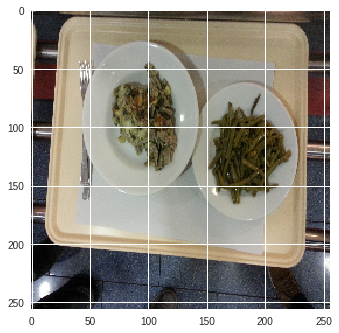

In [12]:
idx=5#0,1,5
img_id=test_ids[idx]

img = imread('data/original/'+img_id+'.jpg')[:,:,:3]
img = resize(img, (256, 256), mode='constant')
# img=img/255.
ROWS,COLS,CHANNELS=img.shape[0],img.shape[1],img.shape[2]
print(ROWS,COLS,CHANNELS)
plt.imshow(img);plt.show()

In [13]:
import keras
from keras import backend as K
import numpy as np

Treat pixels as points in a 5 dimensional feature space.

In [14]:
def features_similarity(u,v,sigma_col=10,sigma_pos=4):
  c1,c2=u[:3],v[:3]
  iu,ju=u[3],u[4]
  iv,jv=v[3],v[4]
  
  dx=K.square(iu-iv)+K.square(ju-jv)
  dx=tf.to_float(dx)
  di=K.sum(K.square(c1-c2))
  di=tf.to_float(di)
  d=di/sigma_col+dx/sigma_pos
  return K.exp(-(di+dx))
#   return tf.cond(dx <= 25, lambda: K.exp(-d), lambda:  0.)

def to_features(img):
  X_col=img
  X_pos=np.zeros((ROWS,COLS,2))
  for i in range(X_pos.shape[0]):
    X_pos[i,:,0]=float(i+1)/ROWS
    X_pos[:,i,1]=float(i+1)/COLS
  X_pos=tf.convert_to_tensor(X_pos,dtype='float32')
  
  X=tf.concat([X_col,X_pos],axis=2)
  X=K.reshape(X,(ROWS*COLS,5))
  return X

X=to_features(img)

def features_similarity_matrix(X):
  print('building similarity matrix')
  W=tf.map_fn(elems=X,
              fn=lambda u: 
              tf.map_fn(elems=X,
                        fn=lambda v: 
                        features_similarity(u,v)),
              dtype='float32')
  #careful, this is lazily evaluated
  return W

In [15]:
import pandas as pd
X_df=pd.DataFrame(K.eval(X),columns=['R','G','B','I','J'])
X_df.head().round(3)

,R,G,B,I,J
0,0.521,0.429,0.355,0.004,0.004
1,0.473,0.347,0.256,0.004,0.008
2,0.428,0.311,0.152,0.004,0.012
3,0.420,0.331,0.188,0.004,0.016
4,0.296,0.272,0.159,0.004,0.020


Design a penalizer for classes having too few pixels so it starts growing from 1 to infinity as the ratio of the class goes from $1/K$ to $0$ (this behaviour is consistent regardless of the number of classes).

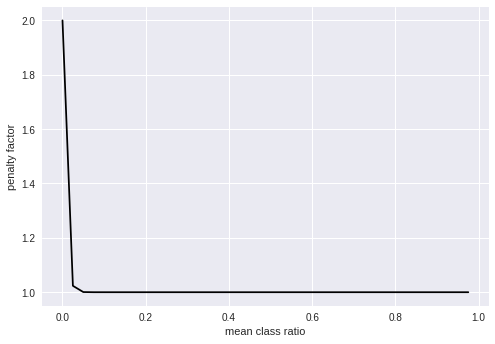

,y
0.000,2.000000
0.025,1.023518
0.050,1.000553
0.075,1.000013
0.100,1.000000


In [16]:
n_classes=10
x=np.arange(0,1,1/n_classes/4)
y=1+np.exp(-x*n_classes*15)#penalize the mean class ratio not being 1/n_classes
plt.plot(x,y,'k')
plt.xlabel('mean class ratio')
plt.ylabel('penalty factor')
# plt.yscale('log')
plt.show()
display(pd.DataFrame(y,x,columns=['y']).head())

In [17]:
def class_ratio_penalty(r,n_classes):
  return tf.to_float(1.)+K.exp(-r*tf.to_float(n_classes)*tf.to_float(15))

Design a penalizer for the perimeter of classes.

In [18]:
def edges_length(P):
  kernel = np.array([[-1,-2,-1],[-2,12,-2],[-1,-2,-1]])
  convolution=K.zeros((ROWS-2,COLS-2,CLASSES))
  for i in range(3):
    ic=i-1#-1,0,1
    for j in range(3):
      jc=j-1#-1,0,1
      convolution+=kernel[i,j]*P[1+ic:ROWS-1+ic,1+jc:COLS-1+jc,:]
  convolution=K.square(convolution)#make it positive and more exagerated
  class_mean_lengths=tf.map_fn(elems=np.arange(CLASSES),
                               fn=lambda k: K.sum(convolution[:,:,k])/K.sum(P[:,:,k]),
                               dtype='float32')
  return K.mean(class_mean_lengths)

## Embedding

just an embedding layer mapping each pixel to a K-probability vector of membership to K classes

put a loss and it optimizes it for only one image

In [19]:
CLASSES=8

In [20]:
def get_enet(loss):
  model=keras.models.Sequential()
  e=keras.layers.Embedding(input_dim=ROWS*COLS,
                           input_length=ROWS*COLS,
                           output_dim=CLASSES,
                           embeddings_constraint=keras.constraints.non_neg(),
                           embeddings_initializer=keras.initializers.normal())
  e.name='embedding'
  model.add(e)
  sm=keras.layers.Lambda(lambda x: K.softmax(x))
  model.add(sm)
  model.summary()
  
  model.compile(optimizer='adam',loss=loss, metrics=['accuracy'])
  return model

Simplified version only adding centroid distances

In [21]:
def centroid_similarity_loss_no_variance(y_true,y_pred):
  img=y_true[0]
  P=y_pred[0]
  X=to_features(img)
  
  centroids = tf.matmul(tf.transpose(P),X)/tf.matmul(tf.transpose(P),tf.ones((ROWS*COLS,1)))

  loss = tf.to_float(0, name='loss')
  for k1 in range(CLASSES):
    centroid_inter_similarity_mean=tf.to_float(0)
    for k2 in range(k1+1,CLASSES):
      loss+=features_similarity(centroids[k1],centroids[k2])
  return loss/(CLASSES*(CLASSES-1)/2)

Fast alternative to the Soft N-cut loss: the centroid loss.

In [22]:
def centroids_similarity_loss(y_true,y_pred):
  img=y_true[0]
  P=y_pred[0]
#   X=to_features(img)
  
  centroids = tf.matmul(tf.transpose(P),X)/tf.matmul(tf.transpose(P),tf.ones((ROWS*COLS,1)))
  variances    = tf.map_fn(elems=np.arange(CLASSES),
                           fn=lambda k: tf.matmul(tf.transpose(P),K.square(X-centroids[k]))/tf.matmul(tf.transpose(P),tf.ones((ROWS*COLS,1))),
                           dtype='float32')#each element is a 5 coord vector RGBIJ
  
    
  loss = tf.to_float(CLASSES, name='loss')
  for k1 in range(CLASSES):
    centroid1=centroids[k1]
    centroid_inter_similarity_mean=tf.to_float(0)
    for k2 in range(k1+1,CLASSES):
      centroid2=centroids[k2]
      centroid_inter_similarity_mean+=features_similarity(centroid1,centroid2,sigma_col=1,sigma_pos=100)
#     loss+=centroid_similarities#*class_ratio_penalty(class_ratios[k1],CLASSES)
    centroid_intra_similarity = features_similarity(variances[k1],tf.zeros_like(variances[k1]),sigma_col=1,sigma_pos=100)#variance is the mean squared distance to the centroid, and similarity is exp(-d**2)
    loss-=centroid_intra_similarity/(centroid_intra_similarity+centroid_inter_similarity_mean)
  #edges
  loss+=edges_length(tf.reshape(P,(ROWS,COLS,CLASSES)))
  return loss

e_net=get_enet(centroids_similarity_loss)

dummy_input=np.arange(ROWS*COLS)
dummy_output=np.random.random((ROWS*COLS,CLASSES))
print('evaluate')
e_net.evaluate(np.array([dummy_input]),np.array([dummy_output]),batch_size=1)

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding (Embedding)        (None, 65536, 8)          524288    
_________________________________________________________________
lambda_1 (Lambda)            (None, 65536, 8)          0         
Total params: 524,288
Trainable params: 524,288
Non-trainable params: 0
_________________________________________________________________
evaluate
1/1 [==============================] - 1s 680ms/step


[5.416228294372559, 0.12664794921875]

Visualization utils

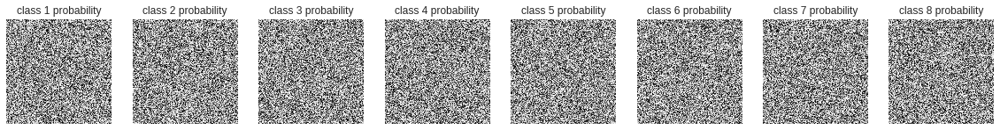

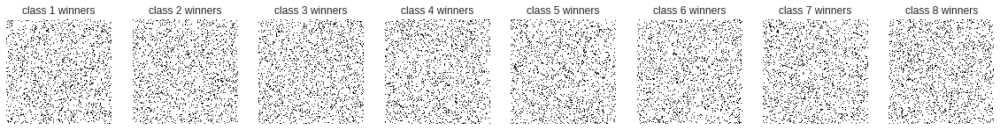

In [23]:
def to_hard_segm_np(P):
  P_hard=np.zeros_like(P)
  for k in range(CLASSES):
    for i in range(ROWS):
      for j in range(COLS):
        P_hard[i,j,np.argmax(P[i,j])]=1
  return P_hard

def to_features_np(img):
  X_col=img
  X_pos=np.zeros((ROWS,COLS,2))
  for i in range(X_pos.shape[0]):
    X_pos[i,:,0]=float(i+1)/ROWS
    X_pos[:,i,1]=float(i+1)/COLS
  
  X=np.concatenate([X_col,X_pos],axis=2)
  X=np.reshape(X,(ROWS*COLS,5))
  return X

def paint_soft_centroid_color(img,P):
  P_vec=P.reshape((ROWS*COLS,P.shape[2]))
  X_np=to_features_np(img)
  centroids = P_vec.T.dot(X_np)/(P_vec.T.dot(np.ones((COLS*ROWS,1))))
  painted_img = np.array([centroids[np.argmax(P_vec[i])][:3] for i in range(ROWS*COLS)]).reshape(ROWS,COLS,CHANNELS)
  return painted_img

def paint_hard_centroid_color(img,P):
  P_hard=to_hard_segm_np(np.reshape(P,(ROWS,COLS,CLASSES)))
  return paint_soft_centroid_color(img,P_hard)

def plot_probabilities(img,P):
  P_vec=P.reshape((ROWS*COLS,CLASSES))
  X_np=to_features_np(img)
  centroids = P_vec.T.dot(X_np)/(P_vec.T.dot(np.ones((COLS*ROWS,1))))
  
  height=20
  plt.figure(figsize=(height,CLASSES*height))
  for k in range(CLASSES):
    plt.subplot(1,CLASSES,k+1)
    class_k_img=np.array([P_vec[i,k] for i in range(ROWS*COLS)]).reshape(ROWS,COLS)
    
    plt.imshow(class_k_img)
    plt.title('class '+str(k+1)+' probability'),plt.xticks([]), plt.yticks([])
  plt.show()

def plot_winners(img,P):
  P_vec=P.reshape((ROWS*COLS,CLASSES))
  X_np=to_features_np(img)
  centroids = P_vec.T.dot(X_np)/(P_vec.T.dot(np.ones((COLS*ROWS,1))))
  
  height=20
  plt.figure(figsize=(height,CLASSES*height))
  for k in range(CLASSES):
    plt.subplot(1,CLASSES,k+1)
    class_k_img=np.array([(np.argmax(P_vec[i])==k) for i in range(ROWS*COLS)]).reshape(ROWS,COLS)
    
    plt.imshow(class_k_img)
    plt.title('class '+str(k+1)+' winners'),plt.xticks([]), plt.yticks([])
  plt.show()

plot_probabilities(img,dummy_output)
plot_winners(img,dummy_output)
# paint_by_mean_color_apart(img,np.reshape(y_s,(ROWS,COLS,CLASSES)))  

from skimage.measure import label
import sklearn.preprocessing

def connectivity_split(img,P):
  '''Split each class into as many connected components it has'''
  P_vec=P.reshape((ROWS*COLS,CLASSES))

  P_new_classes=[]
  for k in range(CLASSES):
    #get the pixels where class k has higher probability than the rest of classes
    class_k_img=np.array([(np.argmax(P_vec[i])==k) for i in range(ROWS*COLS)]).reshape(ROWS,COLS)    
#     plt.imshow(class_k_img);plt.show()
    #assign a label to each connected component
    label_array=label(class_k_img,background=0)
    #one hot
    label_list = label_array.reshape(ROWS*COLS)
    n_labels=max(label_list)+1
#     print('class', k, 'has', n_labels,'connected components')
#     if n_labels>100:
#       print(n_labels, 'are too many components, abandon splitting plot')
#       return
    label_binarizer = sklearn.preprocessing.LabelBinarizer()
    label_binarizer.fit(range(n_labels))
    one_hot = label_binarizer.transform(label_list)
    if n_labels==2:
      one_hot = np.hstack((one_hot, 1 - one_hot))
    one_hot=one_hot.reshape(ROWS,COLS,n_labels)
    one_hot=one_hot[:,:,1:]#delete background class
    P_new_classes.append(one_hot)
  P_new_classes=np.concatenate(P_new_classes,axis=-1)
  
  return paint_soft_centroid_color(img,P_new_classes)

def paints(img,P):  
  plt.figure(figsize=(20,60))
  plt.subplot(1,4,1)
  plt.imshow(img)
  plt.title('original image'),plt.xticks([]), plt.yticks([])
  
  plt.subplot(1,4,2)
  painted_img=paint_soft_centroid_color(img,P)
  plt.imshow(painted_img)
  plt.title('soft centroid color'),plt.xticks([]), plt.yticks([])
  
  plt.subplot(1,4,3)
  painted_img = paint_hard_centroid_color(img,P)
  plt.imshow(painted_img)
  plt.title('hard centroid color'),plt.xticks([]), plt.yticks([])
  
  painted_img = connectivity_split(img,P)
  if painted_img is not None:
    plt.subplot(1,4,4)
    plt.imshow(painted_img)
    plt.title('connect. comp. centroid color'),plt.xticks([]), plt.yticks([])
  
  plt.show()

Utils to compute the Intersection over Union from each class in the ground truth with the best matching region from unsupervised output.

In [24]:
import os
import random
import sys
import warnings
import numpy as np
import pandas as pd
from itertools import chain
from skimage.io import imread, imshow, imread_collection, concatenate_images
from skimage.transform import resize
from skimage.morphology import label
from skimage import img_as_bool
import cv2
import matplotlib.pyplot as plt

def IOU(truth, segm):
  if truth.shape != segm.shape:
    print("Groud truth and segmented image should have the same size.")
    return
  truth = truth/np.max(truth)
  segm = segm/np.max(segm)
  intersection = np.logical_and(truth, segm)
  inter_count = np.sum(intersection)
  union = np.logical_or(truth, segm)
  union_count = np.sum(union)
  iou = inter_count/union_count
  return iou
  
def mean_IOU(truth, segm):
  if truth.shape != segm.shape:
    print("Groud truth and segmented images should have the same size.")
    return
  nb_img = truth.shape[0]
  sum_iou = 0
  for i in range(nb_img):
    sum_iou = sum_iou + IOU(truth[i], segm[i])
  mean_iou = sum_iou/nb_img
  return mean_iou

def get_connectivity_split(img,P):
  '''Split each class into as many connected components it has'''
  P_vec=P.reshape((ROWS*COLS,CLASSES))
  P_new_classes=[]
  for k in range(CLASSES):
    #get the pixels where class k has higher probability than the rest of classes
    class_k_img=np.array([(np.argmax(P_vec[i])==k) for i in range(ROWS*COLS)]).reshape(ROWS,COLS)    
    #assign a label to each connected component
    label_array=label(class_k_img,background=0)
    
    #one hot
    label_list = label_array.reshape(ROWS*COLS)
    n_labels=max(label_list)+1
    label_binarizer = sklearn.preprocessing.LabelBinarizer()
    label_binarizer.fit(range(n_labels))
    one_hot = label_binarizer.transform(label_list)
    if n_labels==2:
      one_hot = np.hstack((one_hot, 1 - one_hot))
    one_hot=one_hot.reshape(ROWS,COLS,n_labels)
    one_hot=one_hot[:,:,1:]#delete background class
    P_new_classes.append(one_hot)
  P_new_classes=np.concatenate(P_new_classes,axis=-1)
  return P_new_classes

def get_best_component_iou(img, truth, P):
  best = 0
  for k in range(P.shape[2]):
    iou = IOU(truth, P[:,:,k])
    if(iou > best):
      best = iou
  return best

def get_best_component(img, truth, P):
  best = 0
  segm = P[:,:,0]
  for k in range(P.shape[2]):
    iou = IOU(truth, P[:,:,k])
    if(iou > best):
      best = iou
      segm = P[:,:,k]
  return segm

def segmentation_IOU(img, segm, i):
  n = 256
  m = 256
  original_mask = 'data/segmented_onehot/'
  mean_IOU = 0
  img_id = test_ids[i]
  count = 0
  sum_IOU = 0
  for j in range(len(classes_ids)):
    fname = original_mask + img_id + '/' + classes_ids[j] + '.png'
    if os.path.isfile(fname):
      truth = imread(fname, flatten=True)
      truth = resize(truth, (256,256), mode='constant', preserve_range=False)
      P = get_connectivity_split(img, segm)
      best_segm = get_best_component_iou(img, truth, P)
      count = count+1
      sum_IOU = sum_IOU + best_segm
  sum_IOU = sum_IOU/count
  mean_IOU = mean_IOU+sum_IOU
  return mean_IOU

Utils for drawing contours

In [25]:
def draw_contours(img, mask_, color):
  mask_2 = np.copy(mask_)
  if(mask_2.ndim == 2):
    mask = np.zeros((img.shape[0],img.shape[1],3))
    integer = 1
    if np.max(mask_2) == 1:
      integer = 255
    mask[:,:,0] = mask_2*integer
    mask[:,:,1] = mask_2*integer
    mask[:,:,2] = mask_2*integer
  else:
    mask = mask_2
    
  mask=mask.astype(np.uint8)
  imgray = cv2.cvtColor(mask,cv2.COLOR_BGR2GRAY)
  ret,thresh = cv2.threshold(imgray,127,255,0)
  mask2, contours, hierarchy = cv2.findContours(thresh,cv2.RETR_TREE,cv2.CHAIN_APPROX_SIMPLE)
  
  img2 = cv2.drawContours(img, contours, -1, color, 15)
  
  return img2

def contours_segmentation(img, mask):
  colors = [(230, 25, 75)	, (60, 180, 75), (255, 225, 25), (0, 130, 200), (245, 130, 48), (145, 30, 180), (70, 240, 240)]
  for i in range(mask.shape[2]):
    img = draw_contours(np.copy(img), np.copy(mask[:,:,i]), colors[i])
  return img

def plot_comparison_contours(img_id, P):
  original = 'data/original/' + img_id + '.jpg'
  original_mask = 'data/segmented_onehot/' + img_id
  
  original_img = imread(original)
  n = original_img.shape[0]
  m = original_img.shape[1]
  count = 0
  ids_class = []
  ids_class_num = []
  for i in range(len(classes_ids)):
    fname = original_mask + '/' + classes_ids[i] + '.png'
    if os.path.isfile(fname):
      ids_class.append(fname)
      ids_class_num.append(i)
      count = count+1
  mask_truth = np.zeros((n,m,count))   
  mask_segm = np.zeros((n,m,count))
  for i in range(count):
    truth = imread(ids_class[i])
    segm_ = get_best_component(resize(original_img, (256, 256), mode='constant') , resize(truth, (256, 256), mode='constant'), P)
    segm = np.zeros((256,256,3))
    segm[:,:,0] = segm_
    segm[:,:,1] = segm_
    segm[:,:,2] = segm_
    segm = resize(segm, original_img.shape, mode='constant', preserve_range= False)
    mask_truth[:,:,i] = truth
    mask_segm[:,:,i] = segm[:,:,0]
  
  img_truth = contours_segmentation(original_img, mask_truth)
  img_unet = contours_segmentation(original_img, mask_segm)
  
  plt.figure(figsize=(20,25))
  plt.subplot(131),plt.imshow(original_img)
  plt.title('Original'), plt.xticks([]), plt.yticks([])
  plt.subplot(132),plt.imshow(img_truth)
  plt.title('Ground truth'), plt.xticks([]), plt.yticks([])
  plt.subplot(133),plt.imshow(img_unet)
  plt.title('W-net'), plt.xticks([]), plt.yticks([])

  plt.show()

#### beans image

In [28]:
idx=5#0,1,5
e_net=get_enet(centroids_similarity_loss)

img_id=test_ids[idx]

img = imread('data/original/'+img_id+'.jpg')[:,:,:3]
img = resize(img, (256, 256), mode='constant')
# img=img/255.
ROWS,COLS,CHANNELS=img.shape[0],img.shape[1],img.shape[2]
X=to_features(img)
X_np=to_features_np(img)

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding (Embedding)        (None, 65536, 8)          524288    
_________________________________________________________________
lambda_2 (Lambda)            (None, 65536, 8)          0         
Total params: 524,288
Trainable params: 524,288
Non-trainable params: 0
_________________________________________________________________


epoch 0
1/1 [==============================] - 1s 938ms/step
[5.370031356811523, 0.1707000732421875]


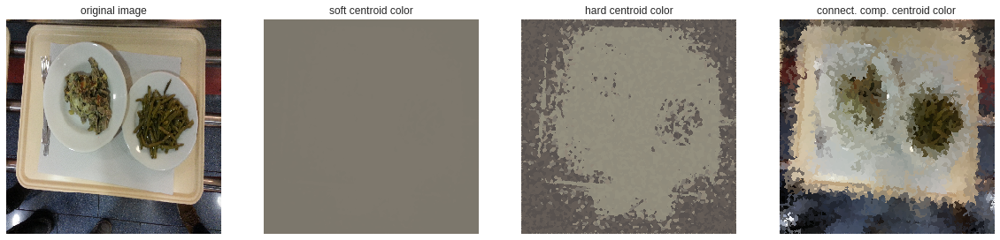

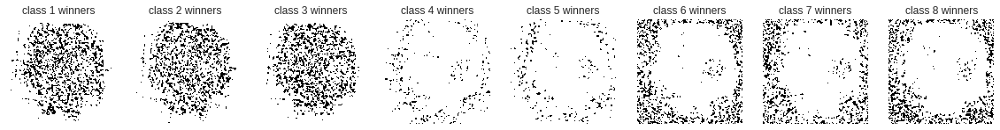

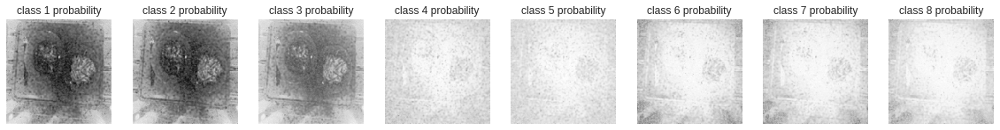

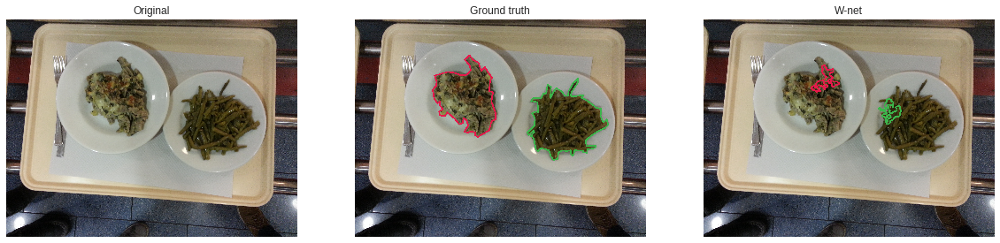

IOU 0.06001824249734674
epoch 200
1/1 [==============================] - 0s 75ms/step
[5.367471218109131, 0.1624908447265625]


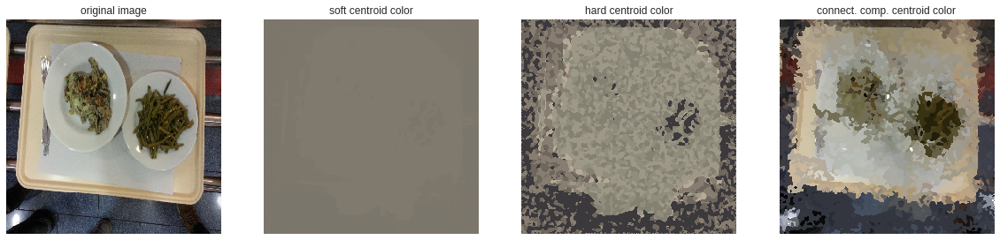

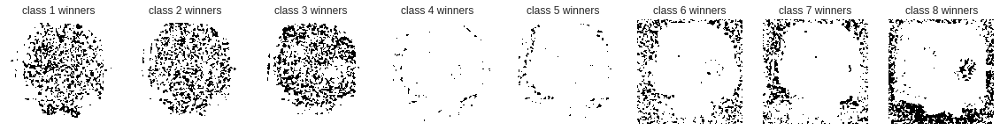

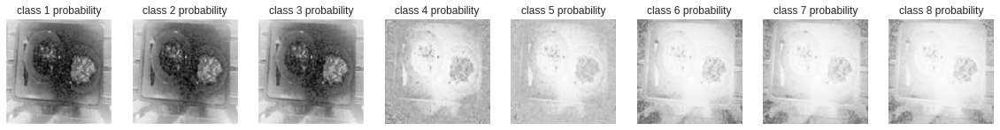

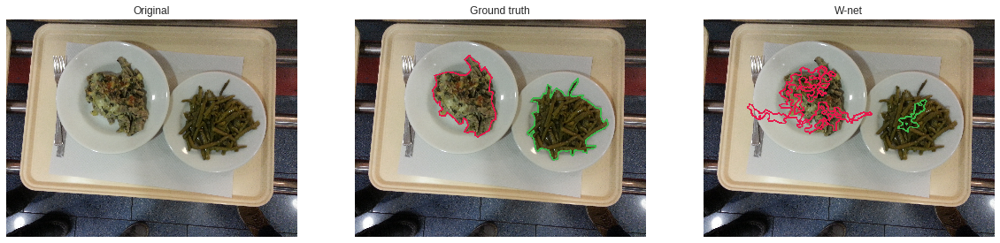

IOU 0.2021075034805012
epoch 400
1/1 [==============================] - 0s 78ms/step
[5.364656448364258, 0.1454010009765625]


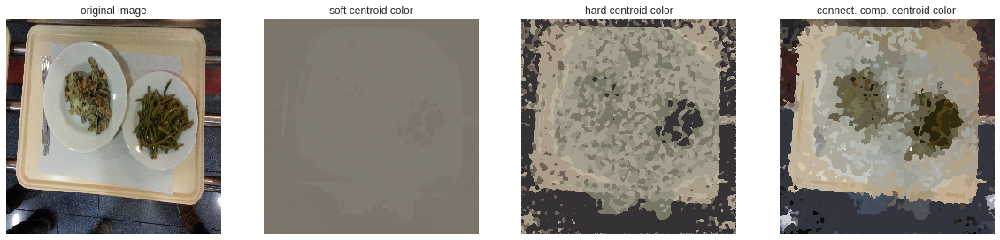

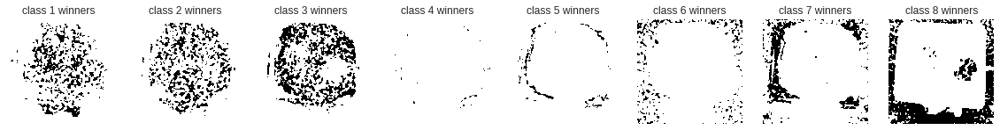

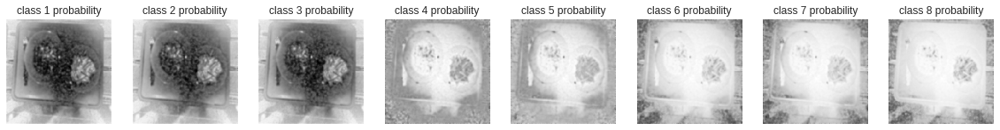

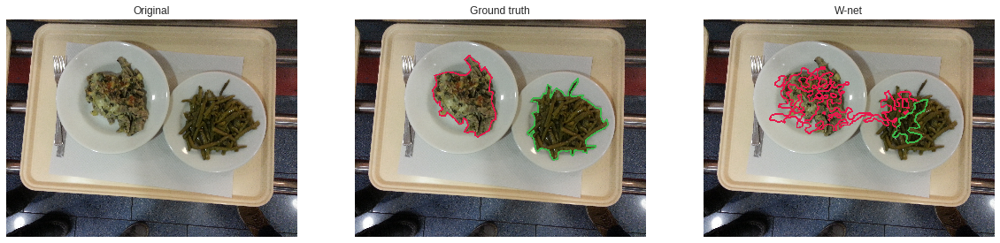

IOU 0.25041370643416583
epoch 600
1/1 [==============================] - 0s 78ms/step
[5.361111640930176, 0.129058837890625]


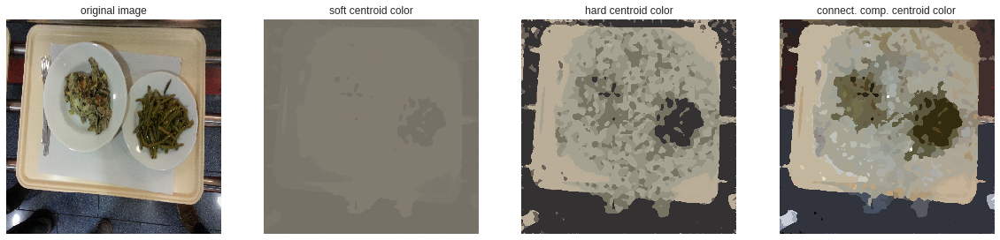

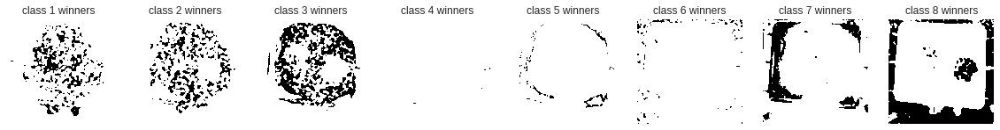

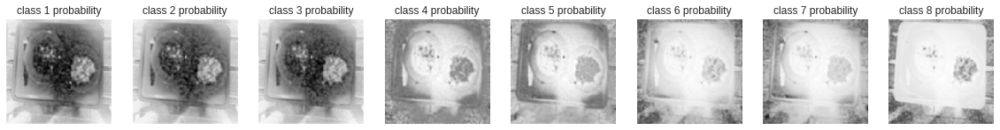

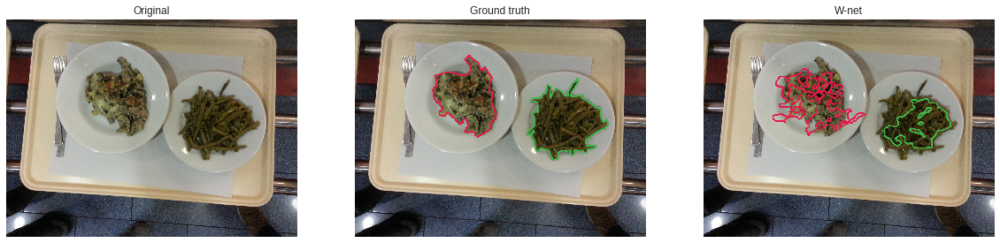

IOU 0.4727012052499475
epoch 800
1/1 [==============================] - 0s 77ms/step
[5.35408878326416, 0.110504150390625]


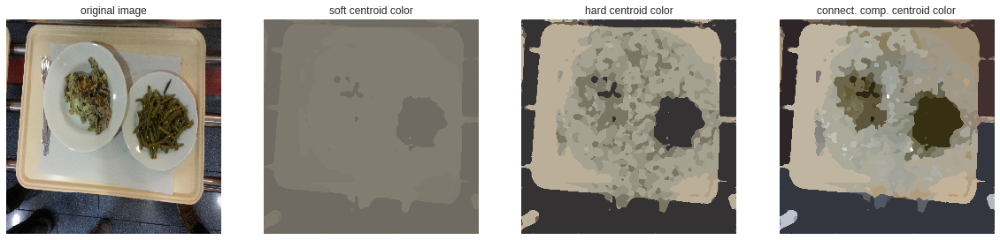

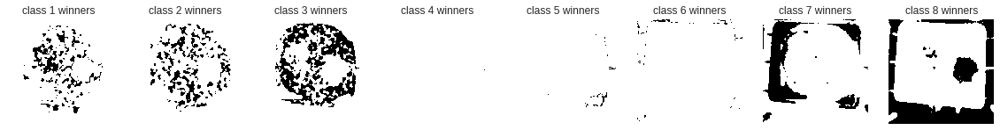

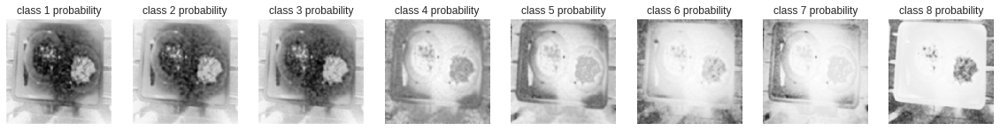

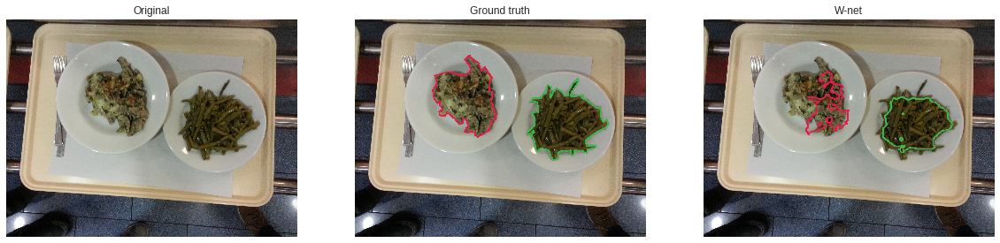

IOU 0.5193313274206168
epoch 1000
1/1 [==============================] - 0s 79ms/step
[5.334819793701172, 0.0991973876953125]


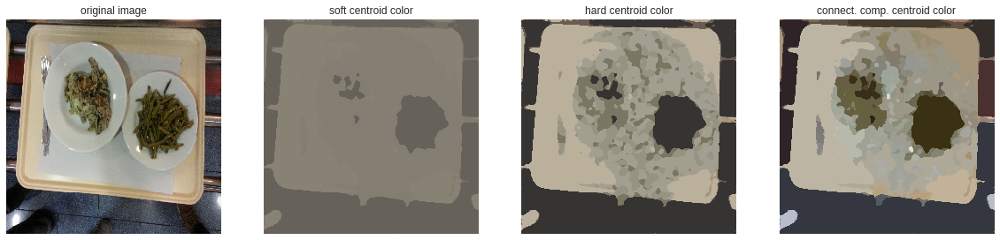

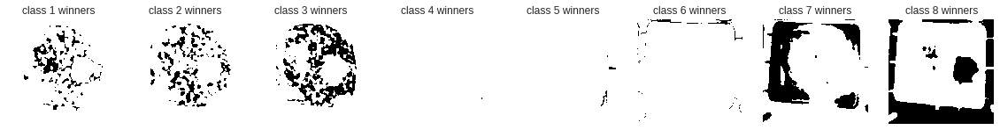

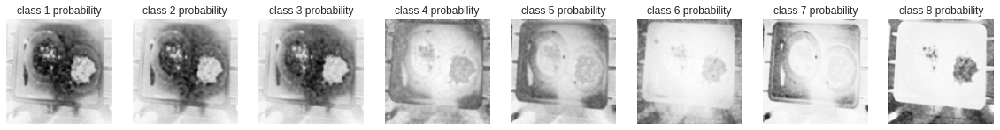

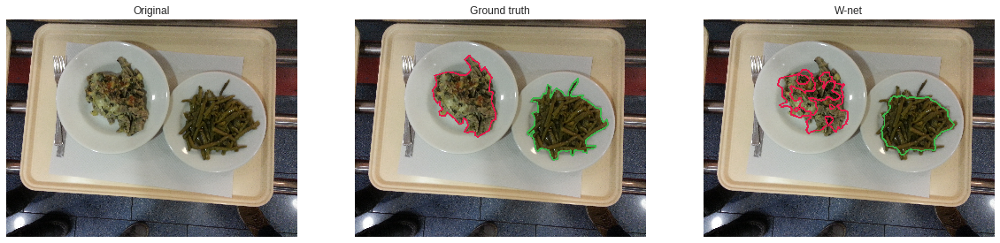

IOU 0.6489787768934817
epoch 1200
1/1 [==============================] - 0s 82ms/step
[5.302369117736816, 0.0900726318359375]


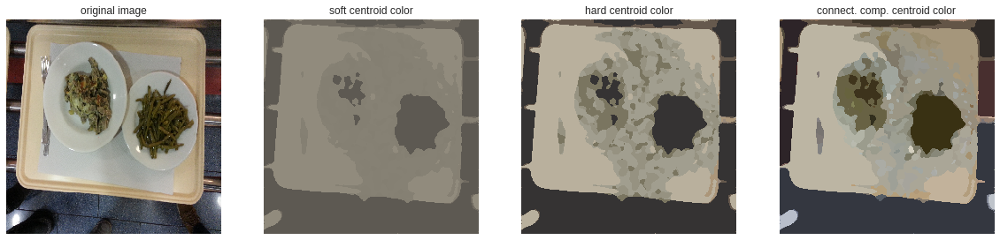

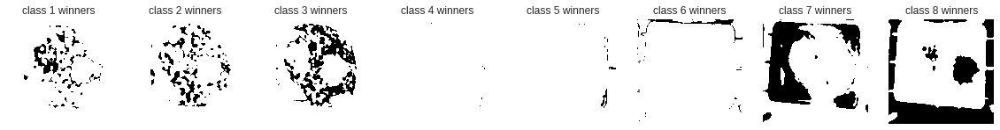

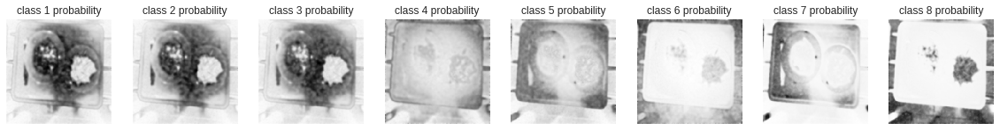

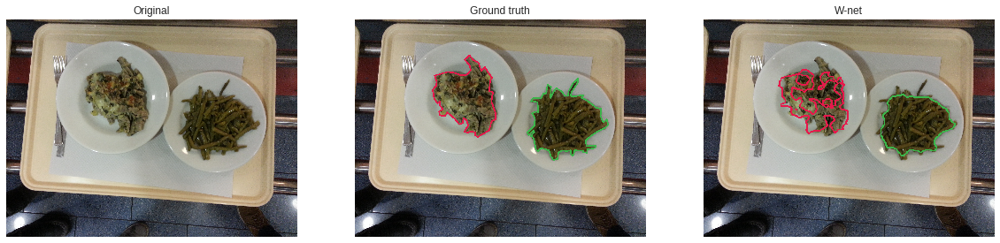

IOU 0.6602043210442652
epoch 1400
1/1 [==============================] - 0s 80ms/step
[5.264106273651123, 0.084503173828125]


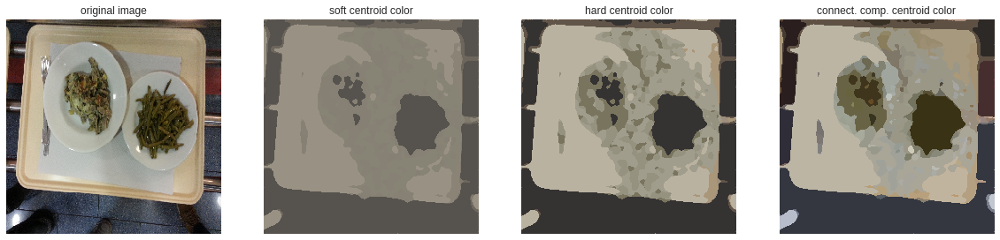

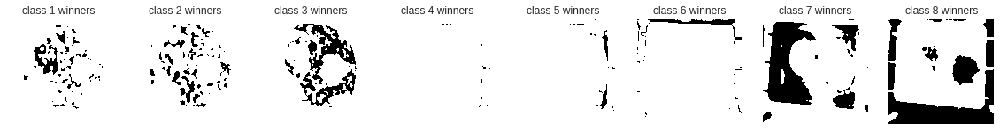

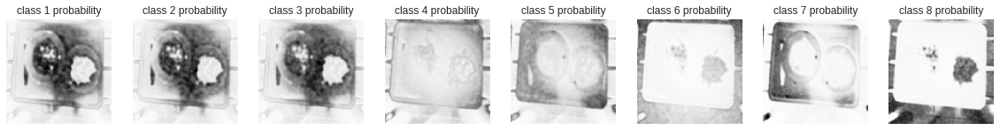

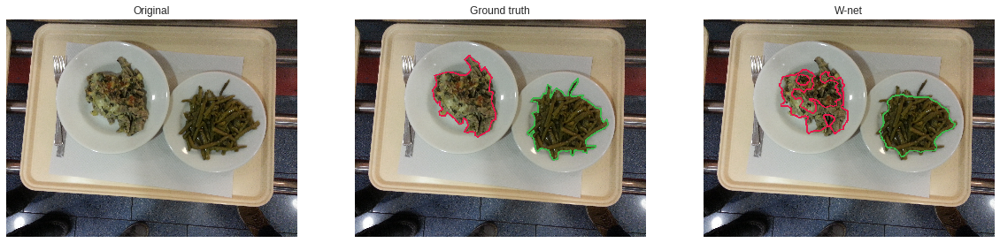

IOU 0.6593208198653816
epoch 1600
1/1 [==============================] - 0s 81ms/step
[5.223081588745117, 0.083282470703125]


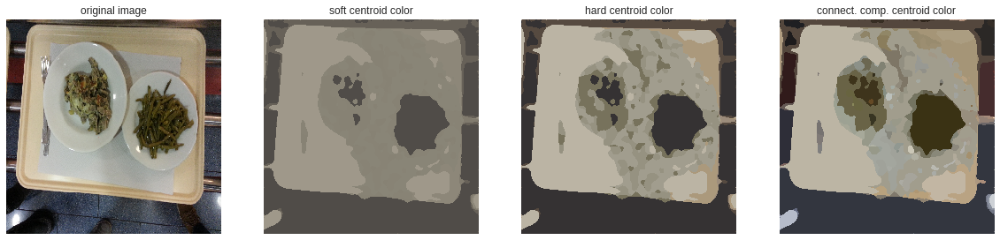

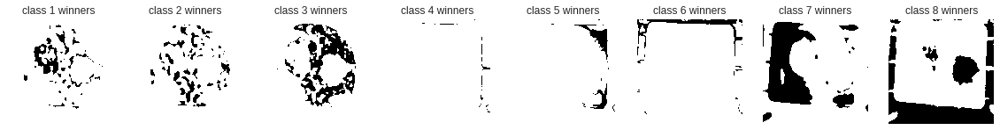

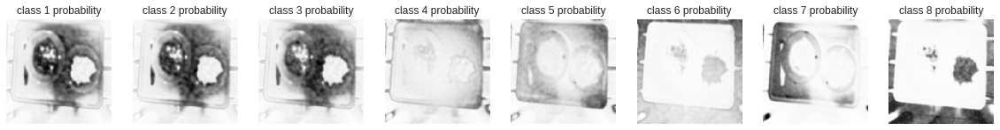

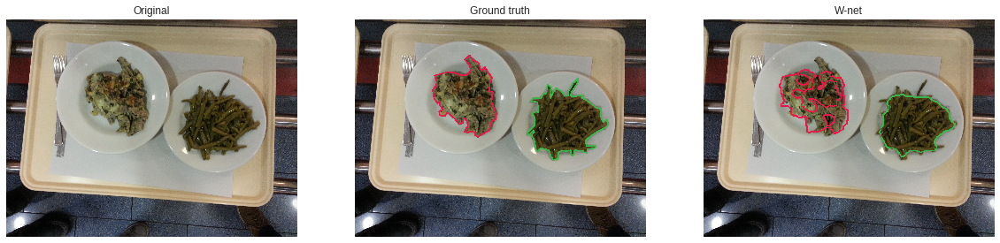

IOU 0.6744946169567043
epoch 1800
1/1 [==============================] - 0s 78ms/step
[5.180365562438965, 0.082427978515625]


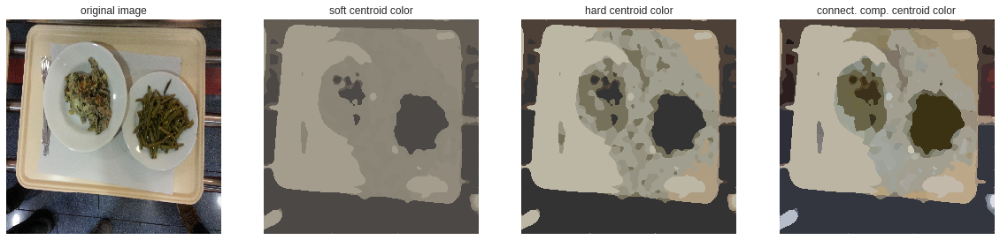

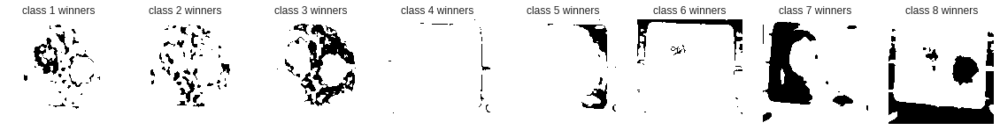

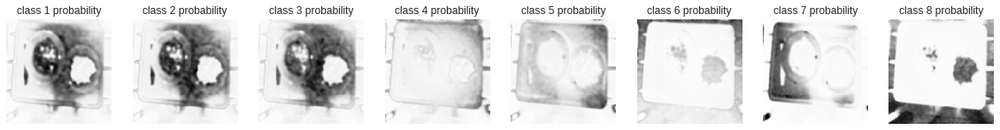

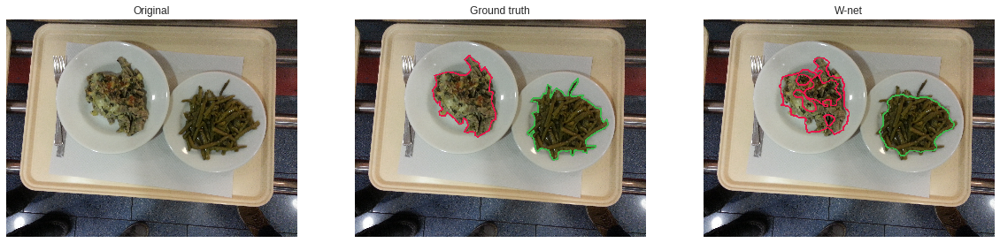

IOU 0.6925827319343414
epoch 2000
1/1 [==============================] - 0s 86ms/step
[5.13627290725708, 0.081817626953125]


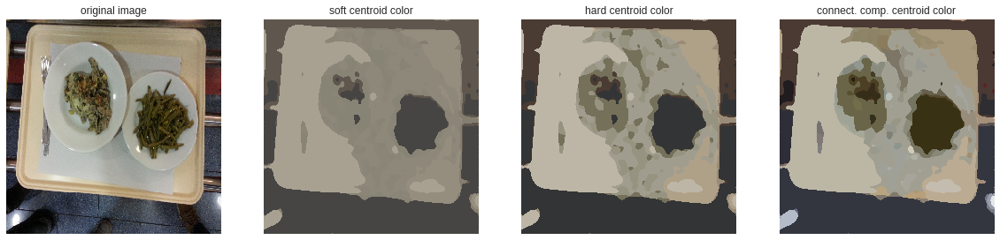

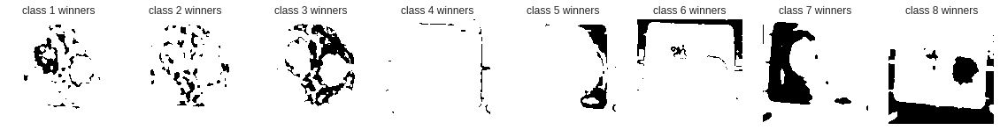

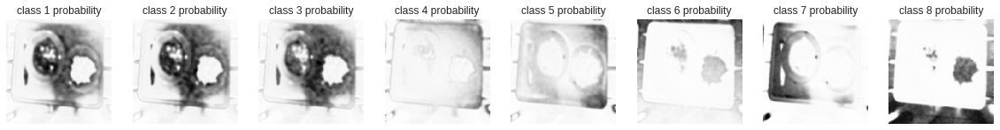

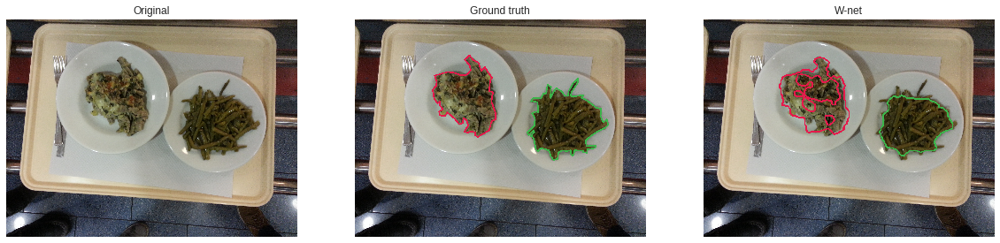

IOU 0.6855623056947573
epoch 2200
1/1 [==============================] - 0s 78ms/step
[5.091954231262207, 0.080841064453125]


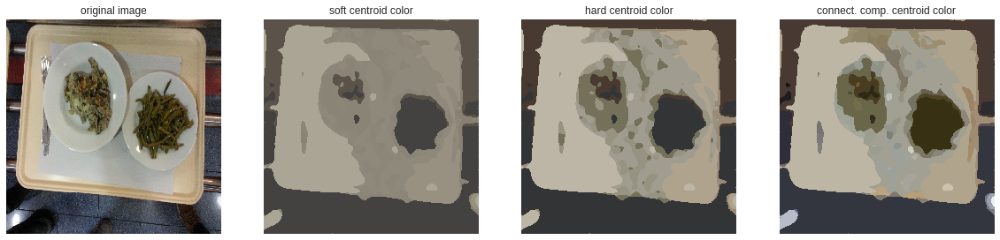

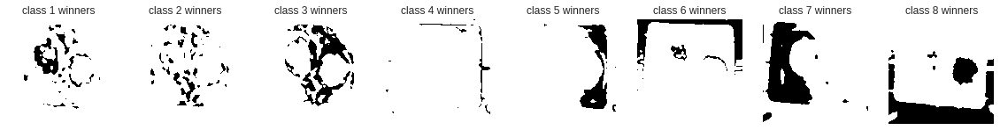

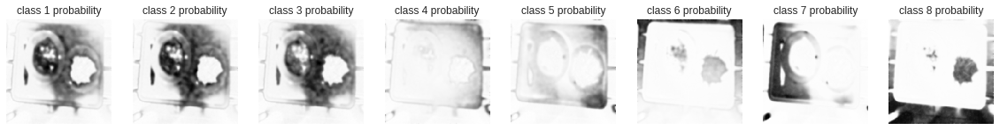

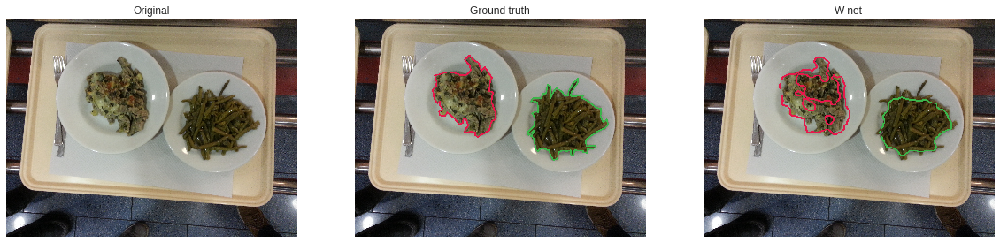

IOU 0.6604154090532133
epoch 2400


KeyboardInterrupt: ignored

In [29]:
for i in range(50):
  print('epoch',i*200)
  history = e_net.fit(np.array([dummy_input]),np.array([img.reshape((ROWS*COLS,CHANNELS))]),
                      batch_size=1,epochs=200,verbose=0)
  print(e_net.evaluate(np.array([dummy_input]),np.array([img.reshape((ROWS*COLS,CHANNELS))])))
  y_s=e_net.predict(np.array([dummy_input]),batch_size=1)[0]
  P=np.reshape(y_s,(ROWS,COLS,CLASSES))
  paints(img,P)
  plot_winners(img,P)
  plot_probabilities(img,P)
  P_ = get_connectivity_split(img, to_hard_segm_np(P))
  plot_comparison_contours(img_id, P_)
  print('IOU',segmentation_IOU(img,P,idx))

#### carrots image

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding (Embedding)        (None, 65536, 8)          524288    
_________________________________________________________________
lambda_4 (Lambda)            (None, 65536, 8)          0         
Total params: 524,288
Trainable params: 524,288
Non-trainable params: 0
_________________________________________________________________


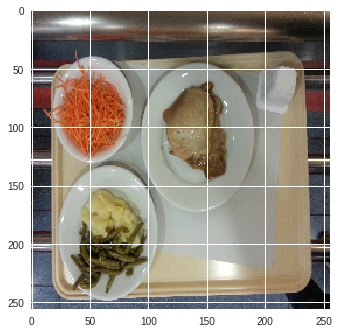

In [32]:
idx=1#0,1,5
e_net=get_enet(centroids_similarity_loss)

img_id=test_ids[idx]

img = imread('data/original/'+img_id+'.jpg')[:,:,:3]
img = resize(img, (256, 256), mode='constant')
plt.imshow(img)
ROWS,COLS,CHANNELS=img.shape[0],img.shape[1],img.shape[2]
X=to_features(img)

epoch 0
1/1 [==============================] - 1s 1s/step
[5.356694221496582, 0.1666412353515625]


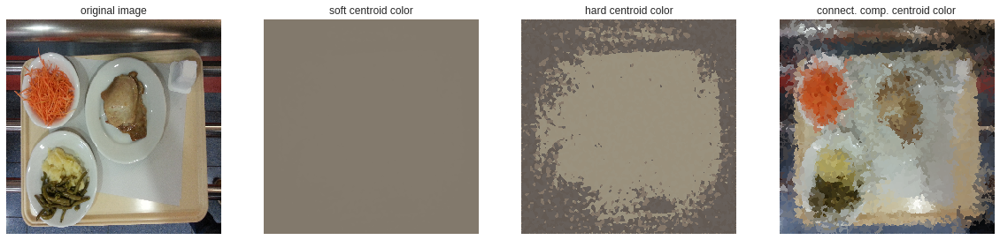

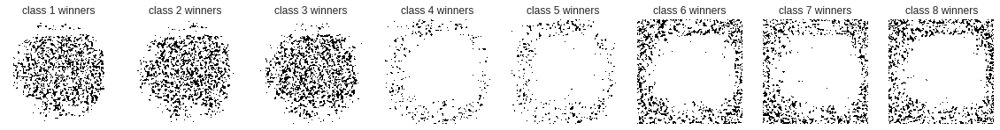

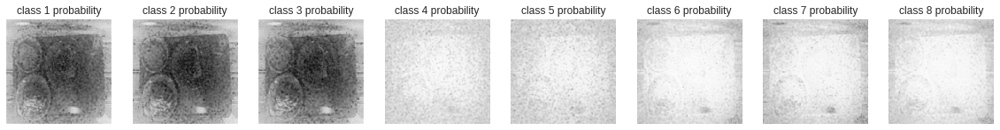

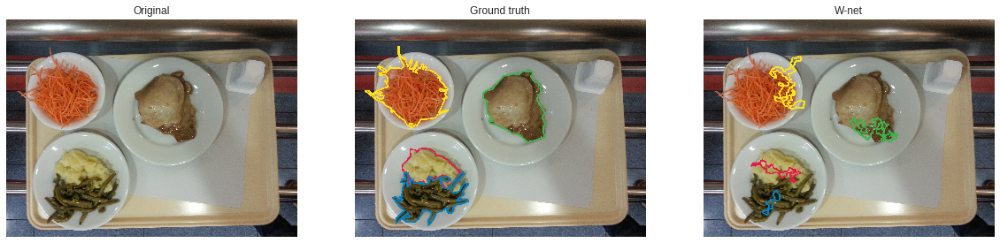

IOU 0.1019486845574536
epoch 200
1/1 [==============================] - 0s 78ms/step
[5.354441165924072, 0.1643829345703125]


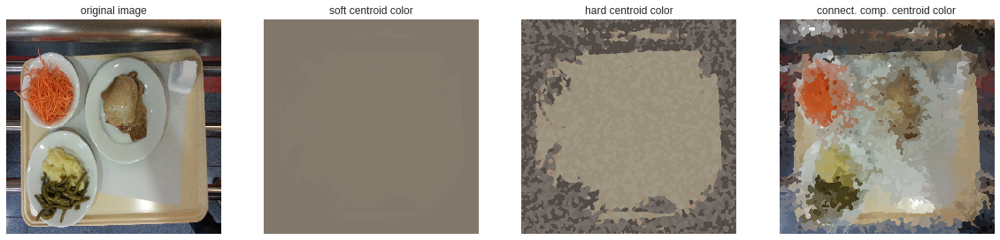

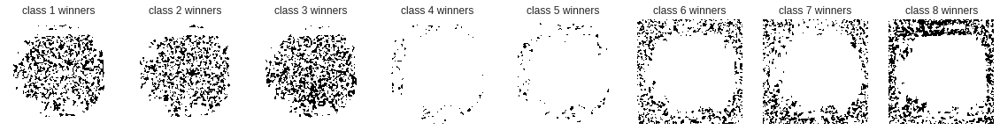

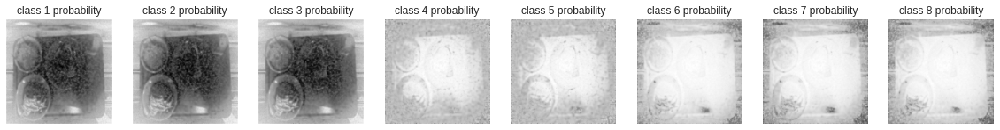

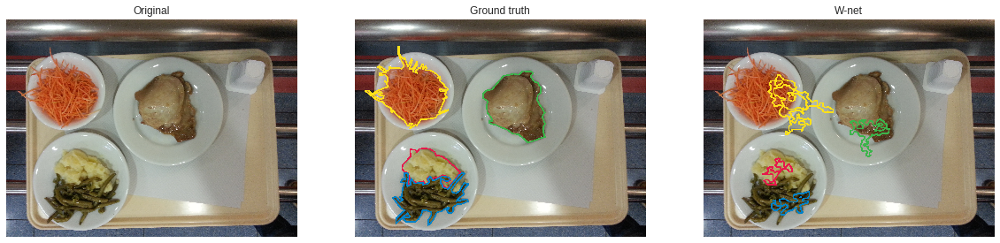

IOU 0.1348766108001936
epoch 400
1/1 [==============================] - 0s 82ms/step
[5.352018356323242, 0.149749755859375]


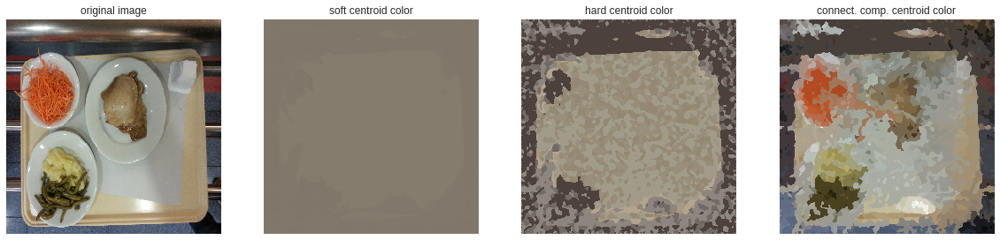

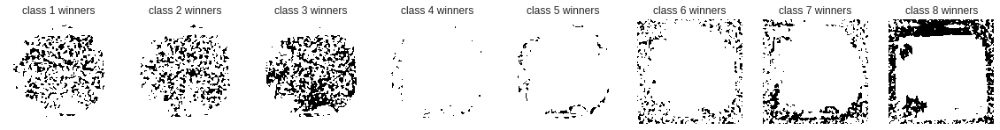

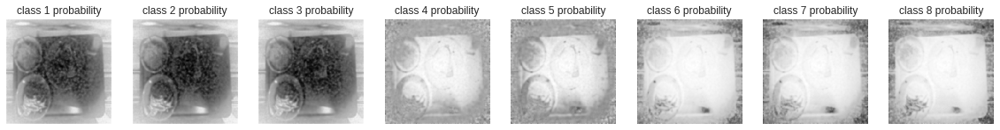

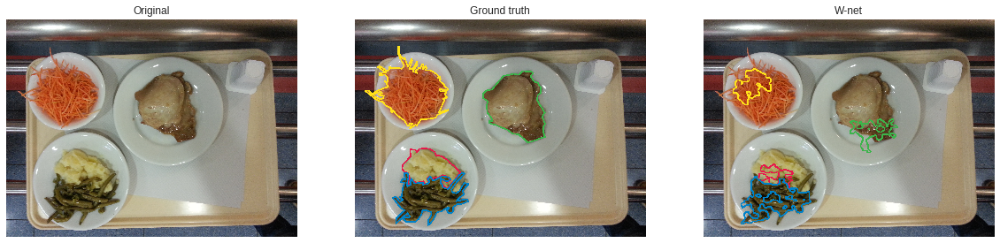

IOU 0.2992021196971917
epoch 600
1/1 [==============================] - 0s 81ms/step
[5.349265098571777, 0.13861083984375]


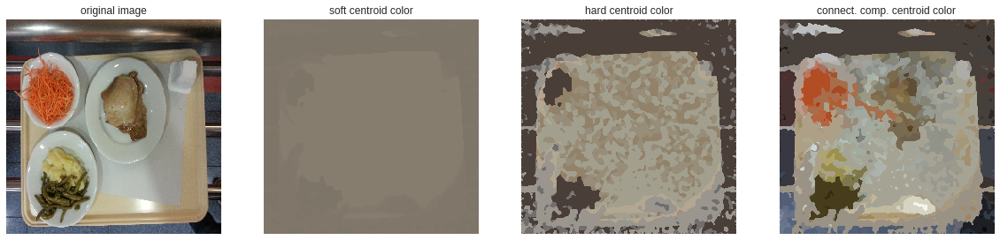

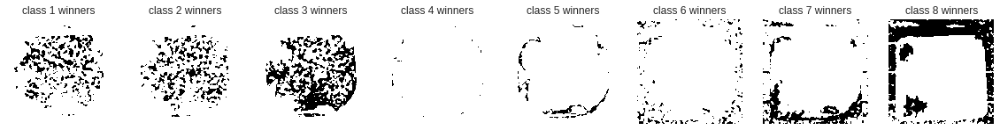

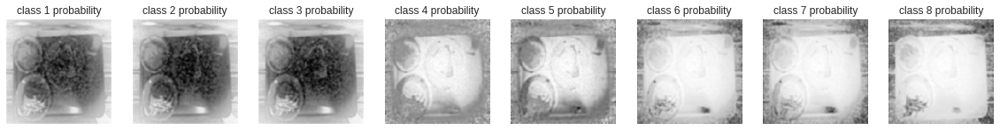

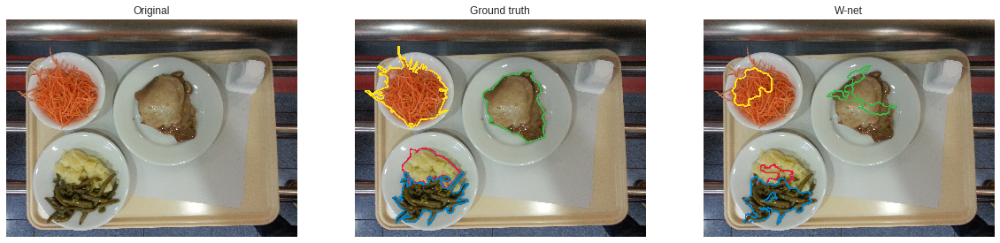

IOU 0.35018701742542657
epoch 800
1/1 [==============================] - 0s 79ms/step
[5.345489501953125, 0.1299285888671875]


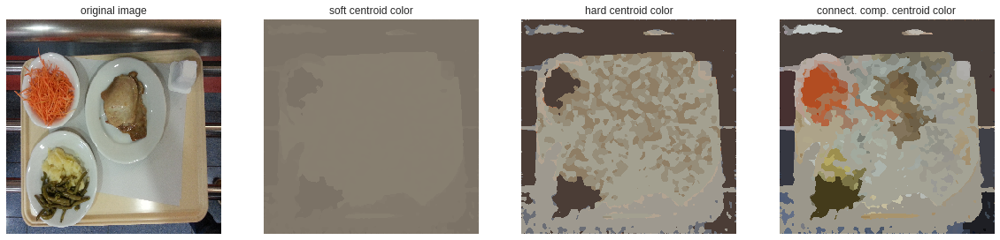

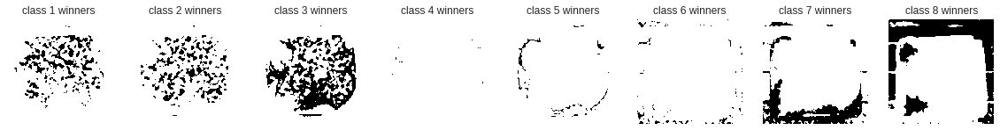

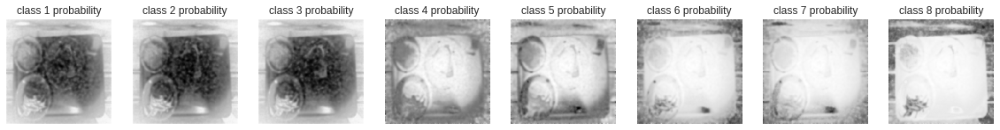

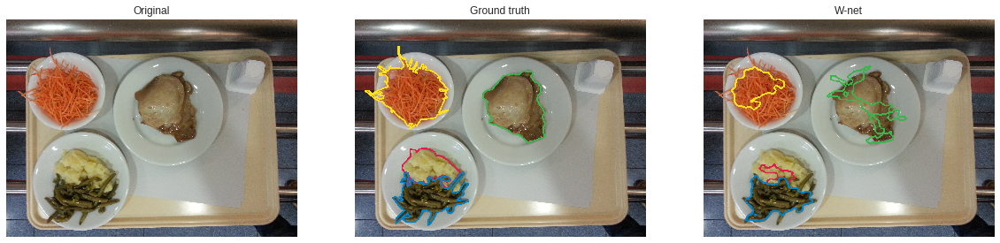

IOU 0.40281422950773116
epoch 1000
1/1 [==============================] - 0s 82ms/step
[5.336496353149414, 0.11962890625]


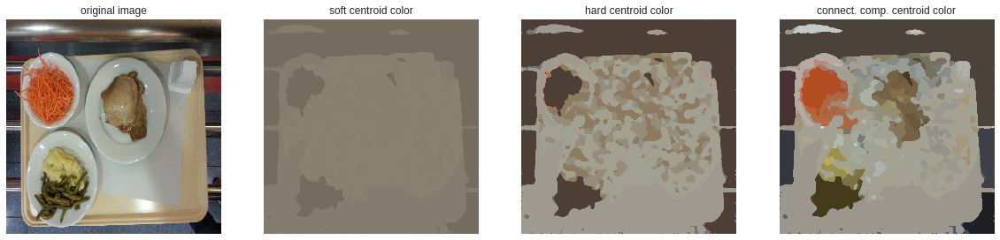

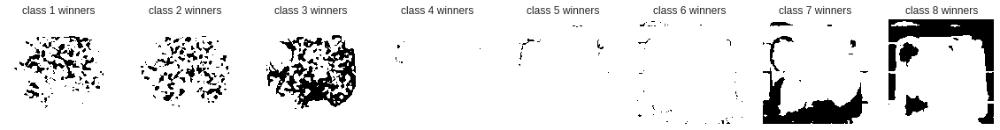

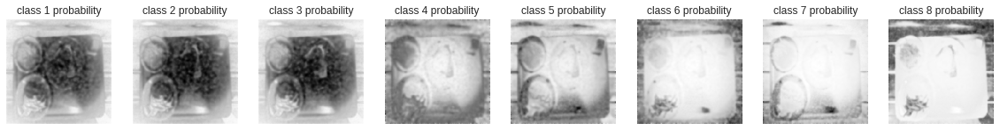

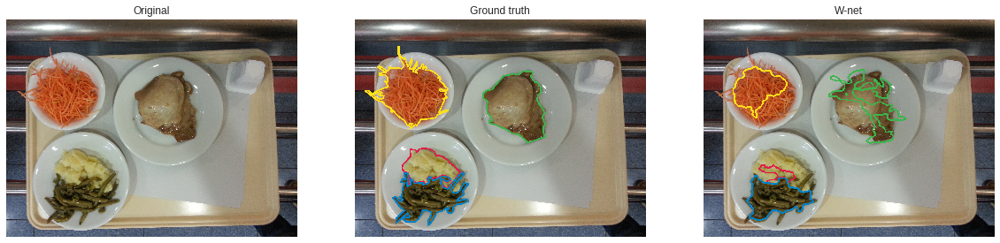

IOU 0.44972569892958547
epoch 1200
1/1 [==============================] - 0s 79ms/step
[5.315495014190674, 0.110443115234375]


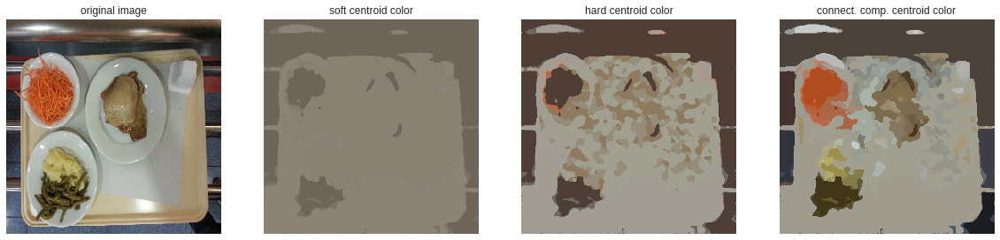

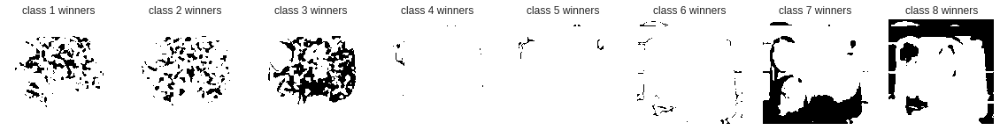

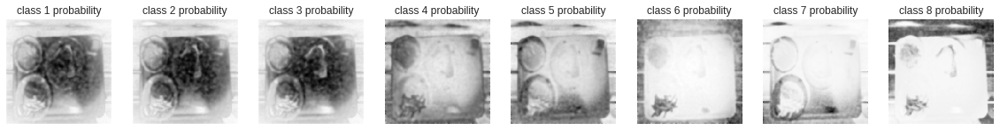

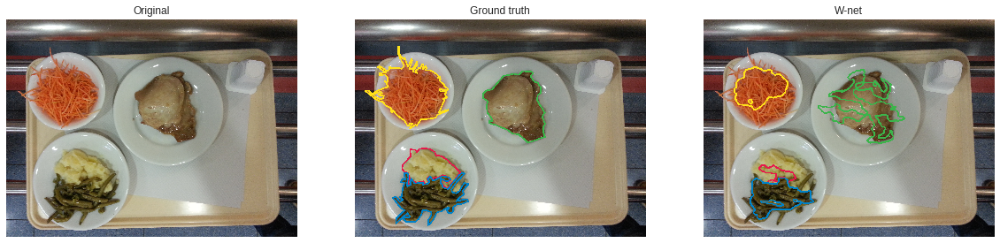

IOU 0.43831445691367726
epoch 1400
1/1 [==============================] - 0s 81ms/step
[5.286495685577393, 0.1011810302734375]


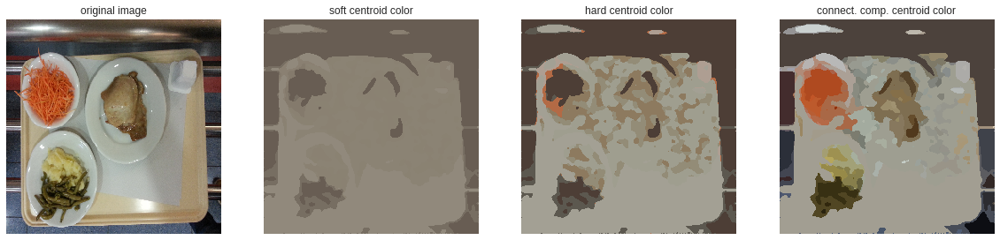

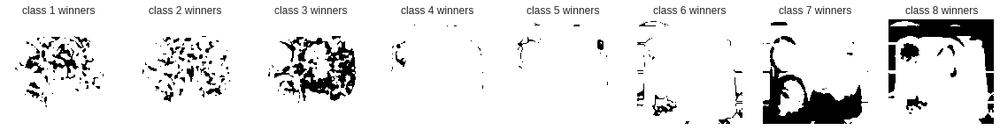

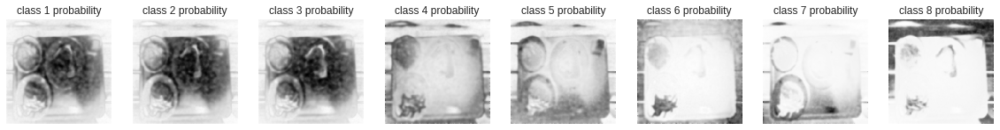

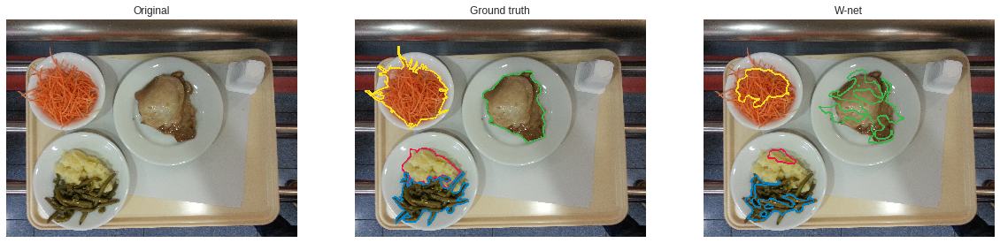

IOU 0.35087350670567496
epoch 1600


KeyboardInterrupt: ignored

In [33]:
for i in range(50):
  print('epoch',i*200)
  history = e_net.fit(np.array([dummy_input]),np.array([img.reshape((ROWS*COLS,CHANNELS))]),
                      batch_size=1,epochs=200,verbose=0)
  print(e_net.evaluate(np.array([dummy_input]),np.array([img.reshape((ROWS*COLS,CHANNELS))])))
  y_s=e_net.predict(np.array([dummy_input]),batch_size=1)[0]
  P=np.reshape(y_s,(ROWS,COLS,CLASSES))
  paints(img,P)
  plot_winners(img,P)
  plot_probabilities(img,P)
  P_ = get_connectivity_split(img, to_hard_segm_np(P))
  plot_comparison_contours(img_id, P_)
  print('IOU',segmentation_IOU(img,P,idx))

#### pizza image

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding (Embedding)        (None, 65536, 8)          524288    
_________________________________________________________________
lambda_3 (Lambda)            (None, 65536, 8)          0         
Total params: 524,288
Trainable params: 524,288
Non-trainable params: 0
_________________________________________________________________


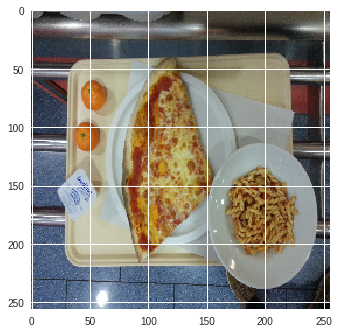

In [27]:
idx=0#0,1,5
e_net=get_enet(centroids_similarity_loss)

img_id=test_ids[idx]

img = imread('data/original/'+img_id+'.jpg')[:,:,:3]
img = resize(img, (256, 256), mode='constant')
plt.imshow(img)
ROWS,COLS,CHANNELS=img.shape[0],img.shape[1],img.shape[2]
X=to_features(img)

epoch 0
1/1 [==============================] - 1s 616ms/step
[5.356367111206055, 0.16448974609375]


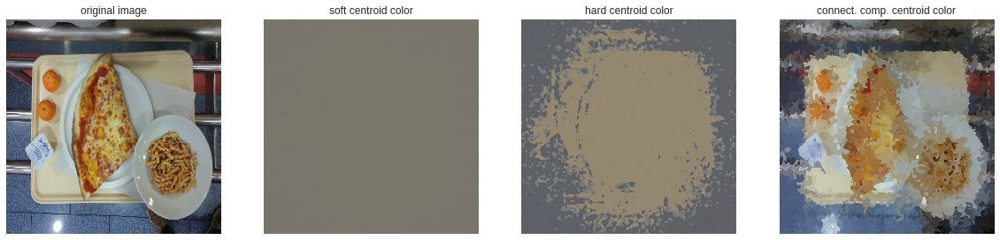

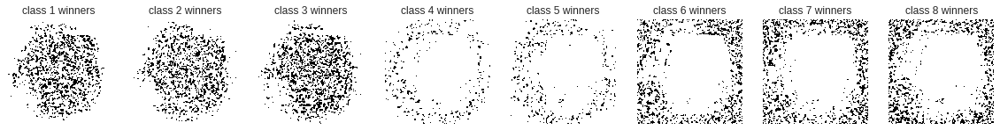

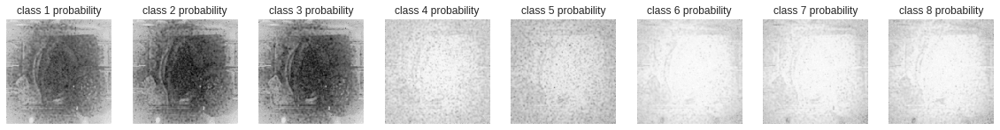

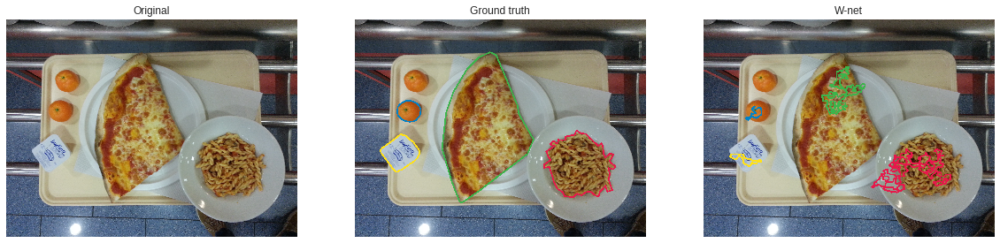

IOU 0.13612534200351065
epoch 200
1/1 [==============================] - 0s 79ms/step
[5.354399681091309, 0.1639251708984375]


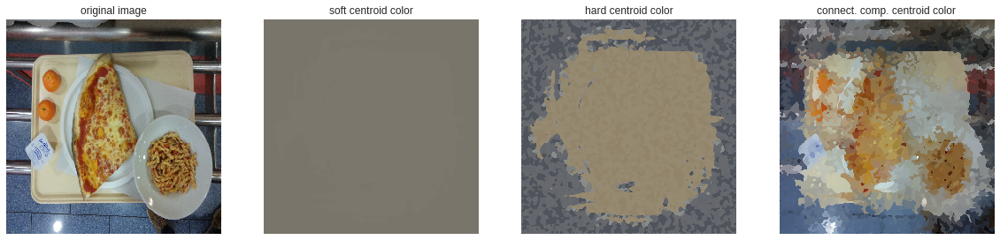

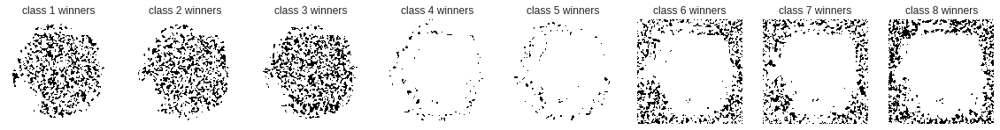

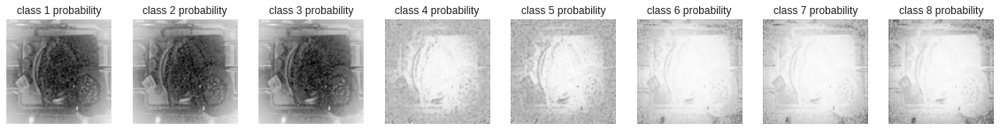

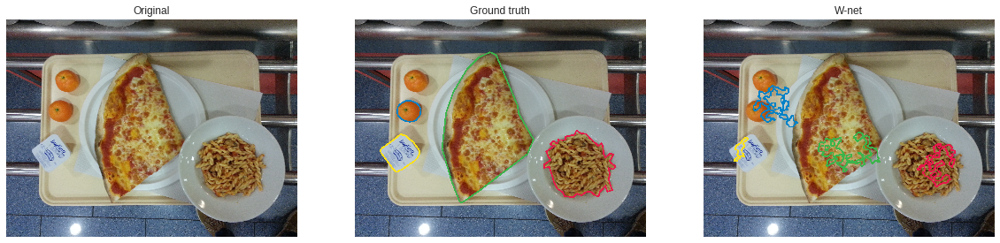

IOU 0.12118750793003069
epoch 400
1/1 [==============================] - 0s 76ms/step
[5.352308750152588, 0.154632568359375]


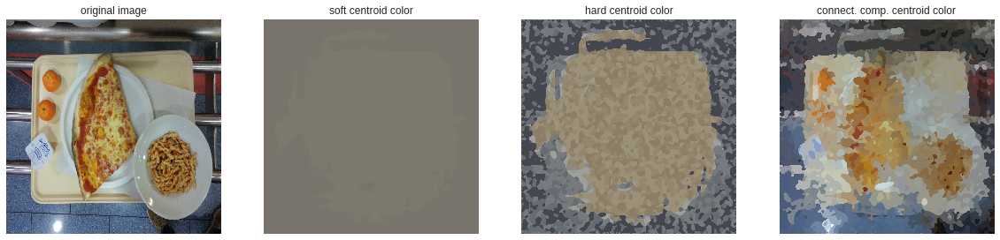

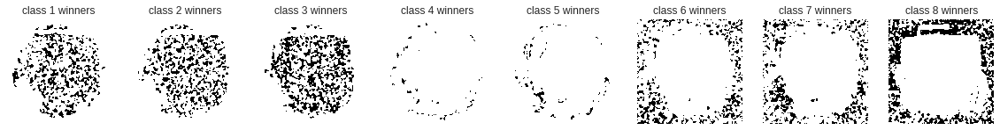

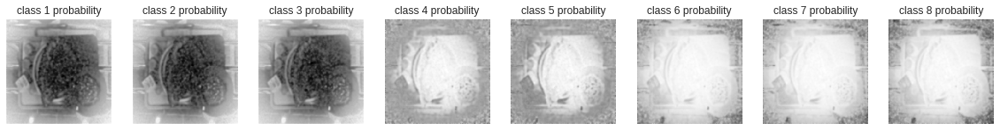

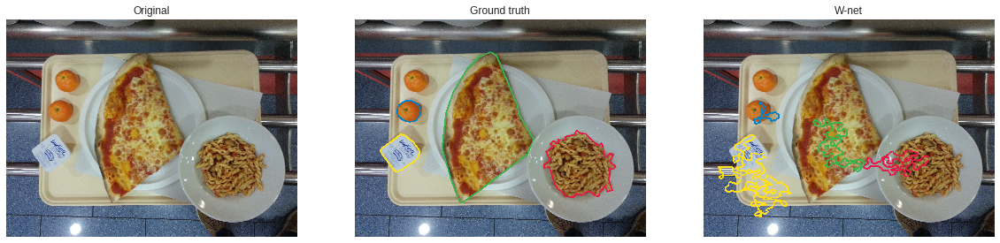

IOU 0.13723571479769858
epoch 600
1/1 [==============================] - 0s 83ms/step
[5.350001811981201, 0.148956298828125]


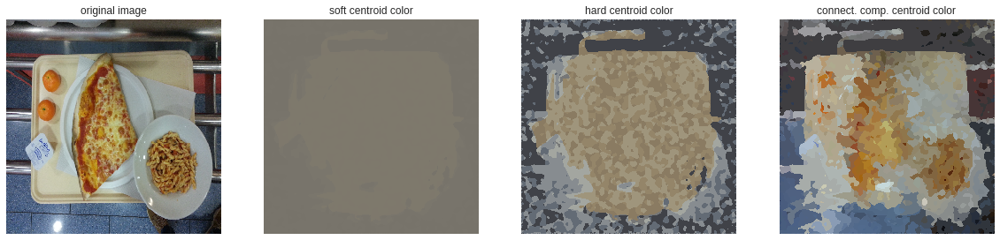

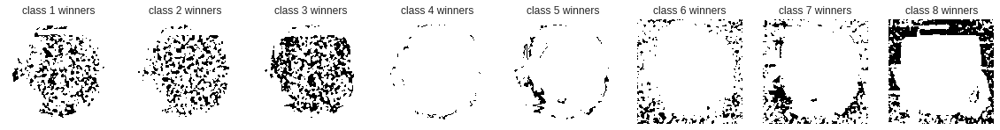

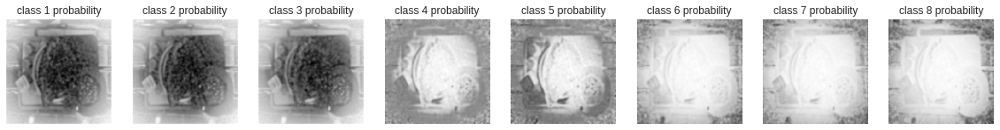

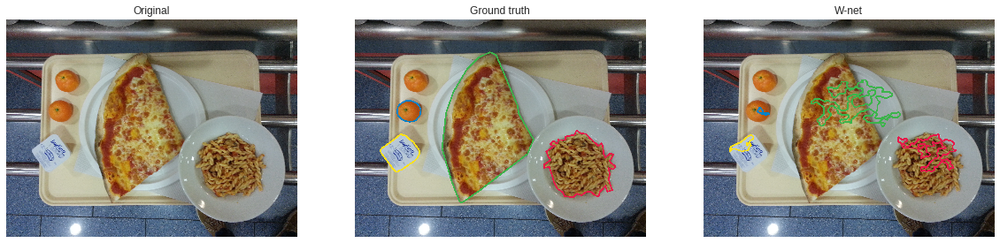

IOU 0.1353814172327988
epoch 800
1/1 [==============================] - 0s 82ms/step
[5.347265720367432, 0.142822265625]


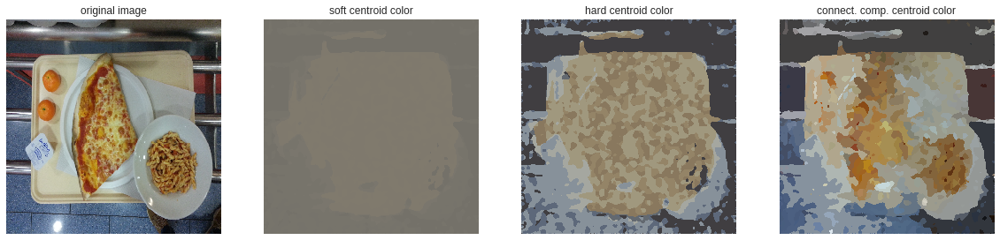

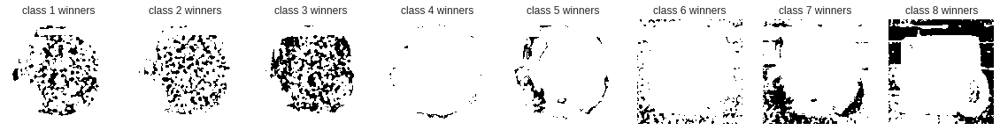

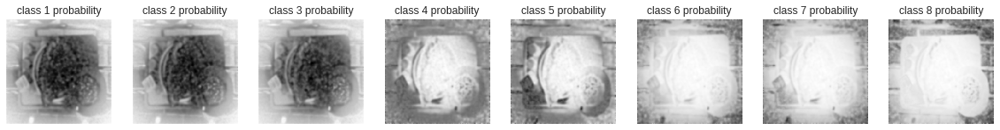

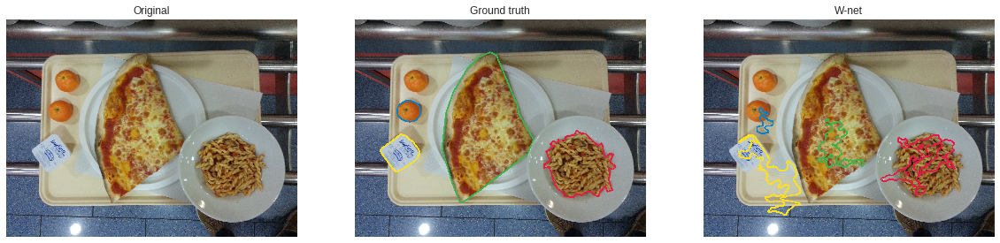

IOU 0.17038956127259547
epoch 1000
1/1 [==============================] - 0s 78ms/step
[5.342398166656494, 0.1362457275390625]


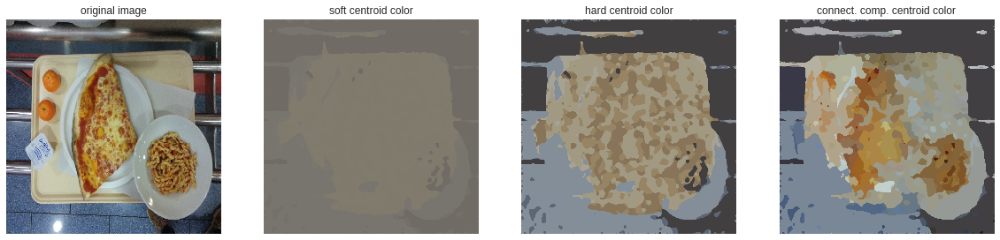

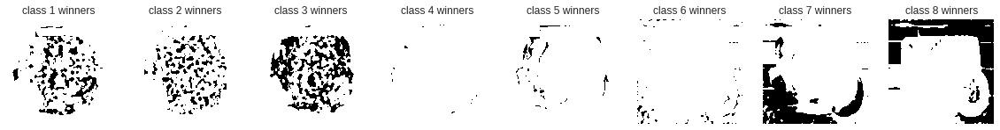

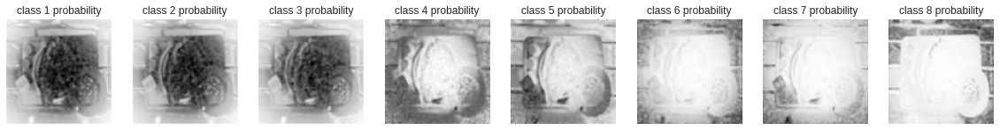

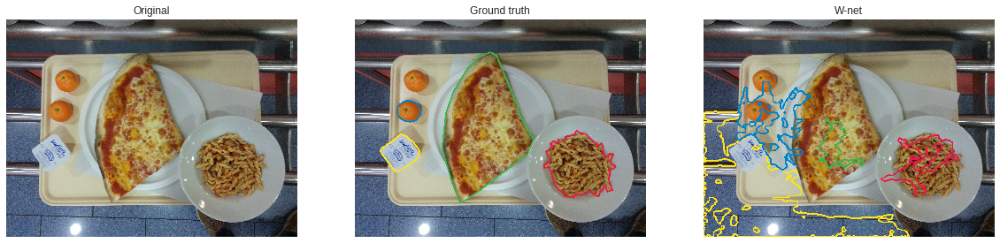

IOU 0.15741528274170186
epoch 1200
1/1 [==============================] - 0s 77ms/step
[5.32866096496582, 0.125244140625]


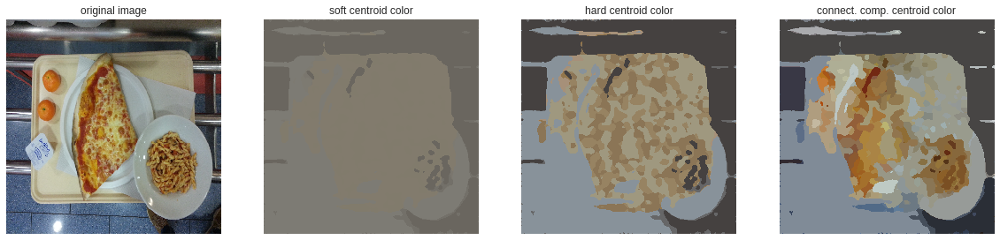

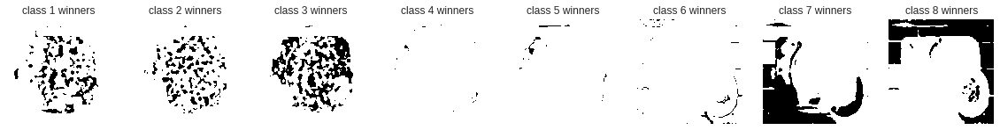

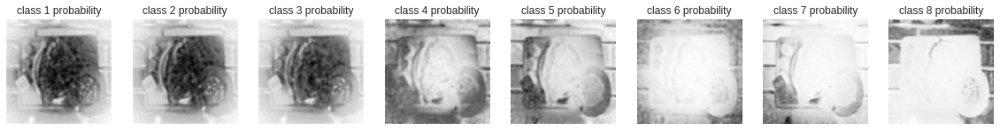

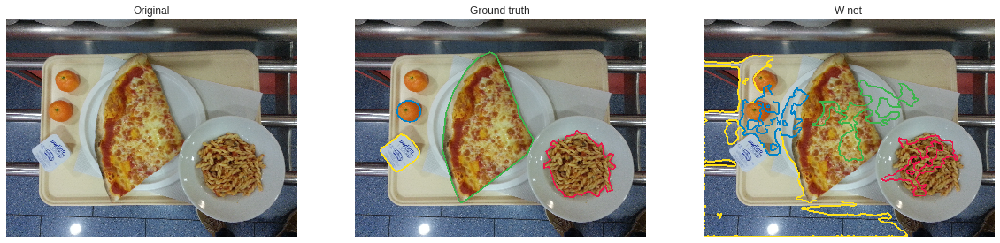

IOU 0.1647626376089532
epoch 1400
1/1 [==============================] - 0s 87ms/step
[5.304750442504883, 0.1158599853515625]


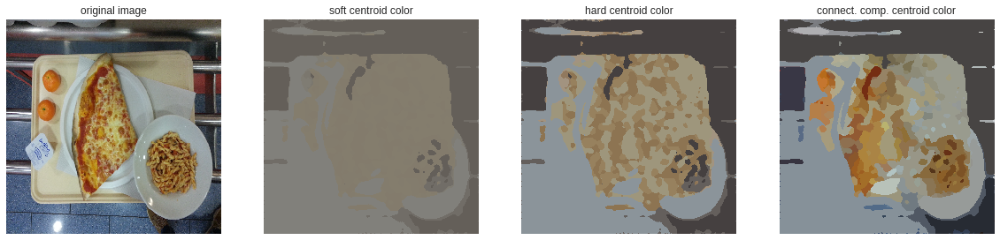

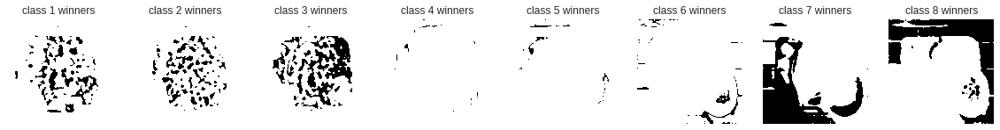

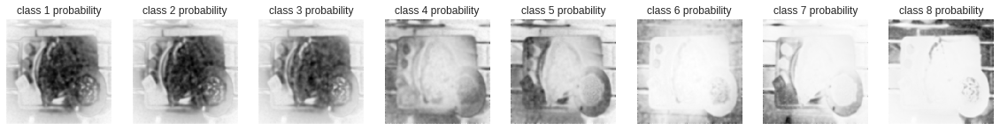

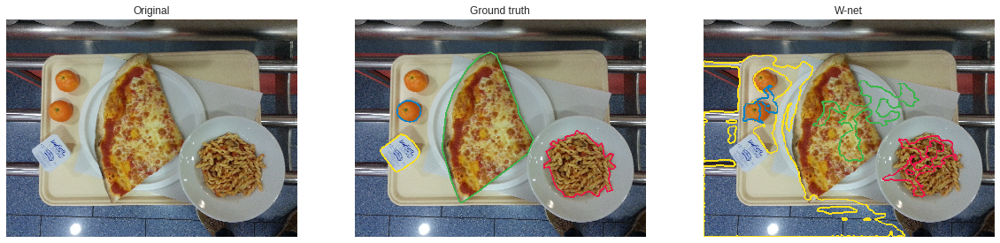

IOU 0.21738784790362495
epoch 1600
1/1 [==============================] - 0s 78ms/step
[5.275707244873047, 0.111572265625]


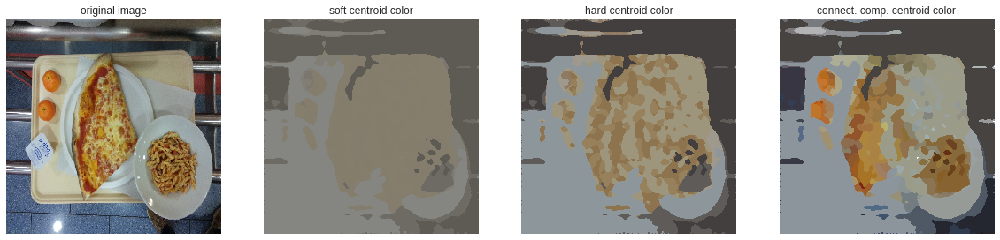

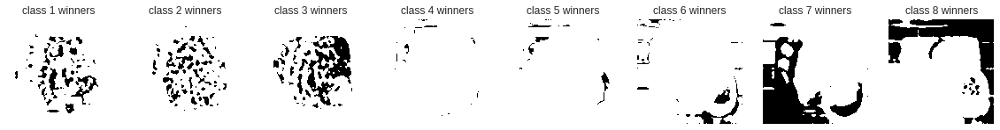

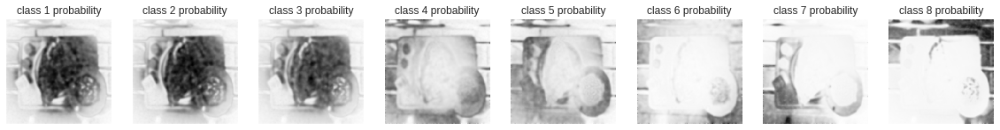

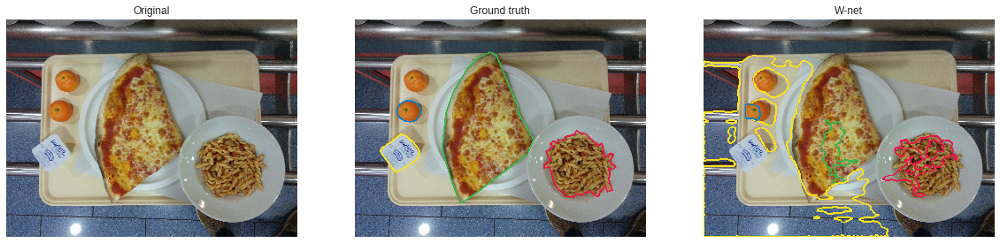

IOU 0.22664573112935593
epoch 1800
1/1 [==============================] - 0s 79ms/step
[5.244262218475342, 0.1088104248046875]


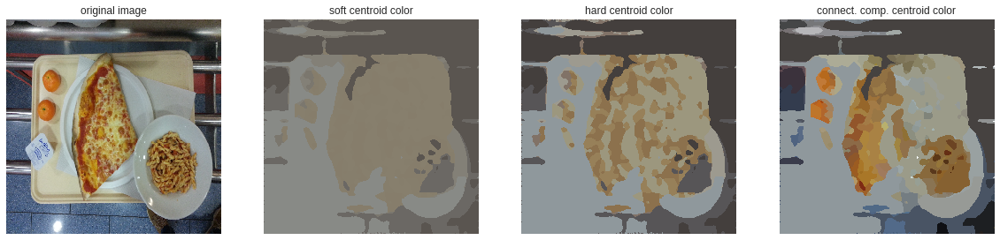

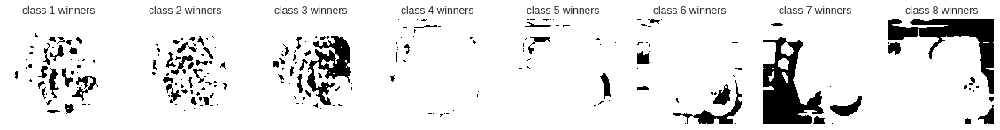

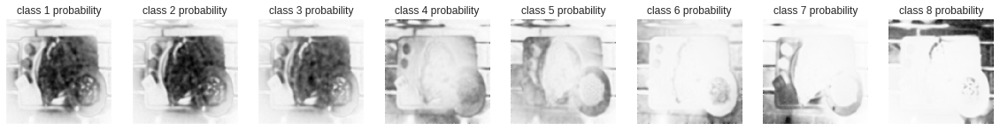

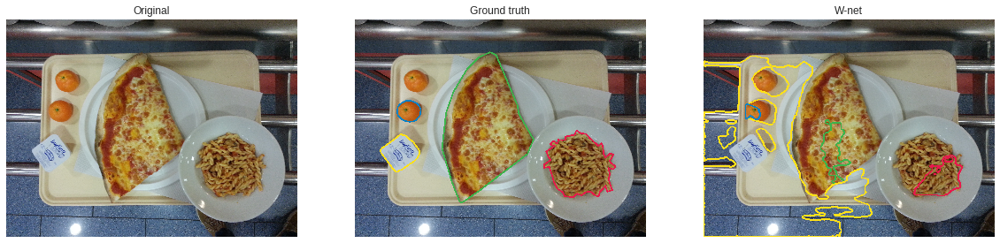

IOU 0.20940228625344762
epoch 2000
1/1 [==============================] - 0s 78ms/step
[5.210756778717041, 0.105682373046875]


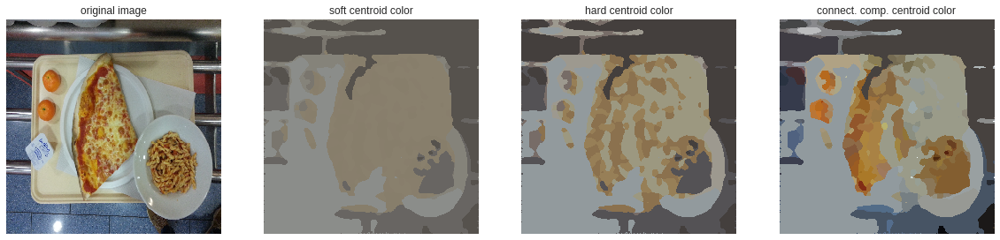

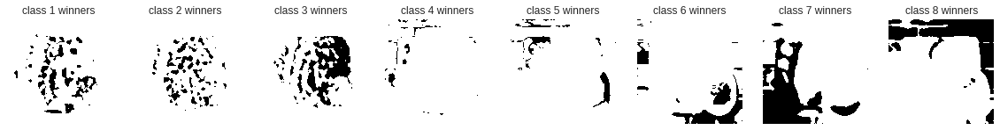

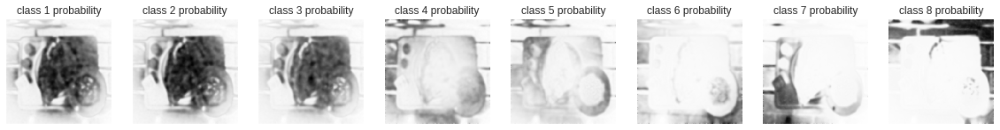

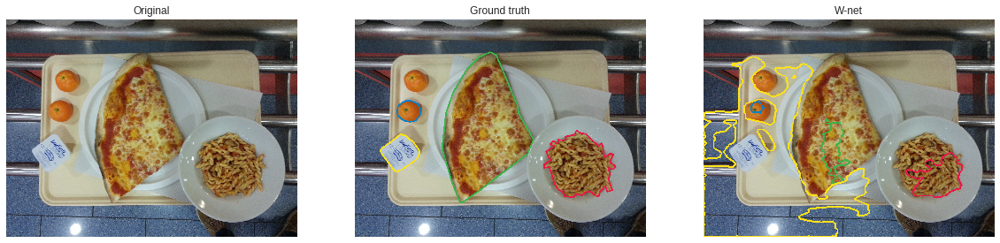

IOU 0.20841275592842773
epoch 2200
1/1 [==============================] - 0s 85ms/step
[5.17458963394165, 0.1021270751953125]


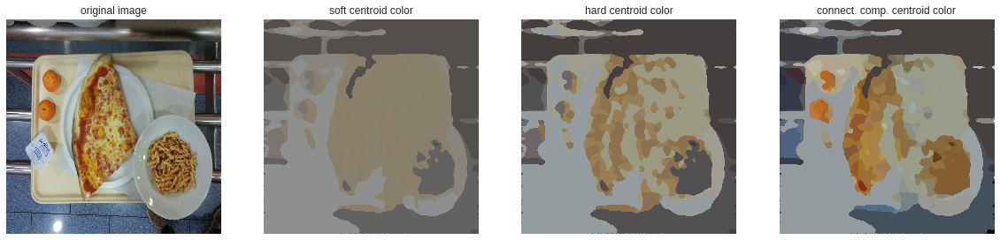

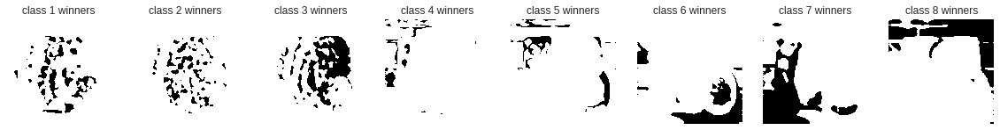

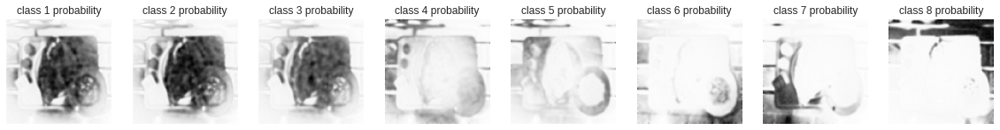

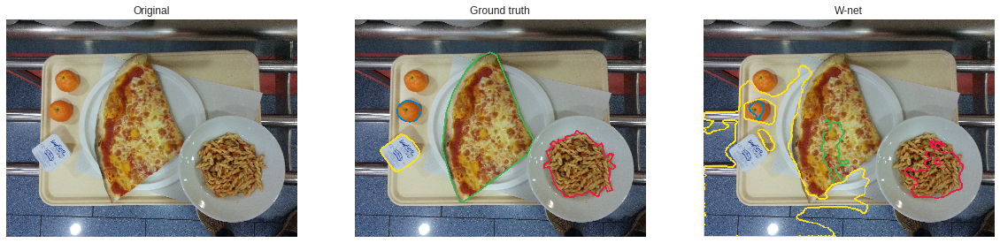

IOU 0.2729175735951641
epoch 2400
1/1 [==============================] - 0s 79ms/step
[5.136177062988281, 0.100341796875]


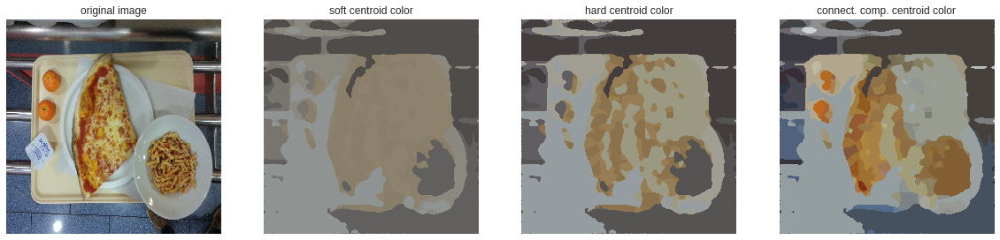

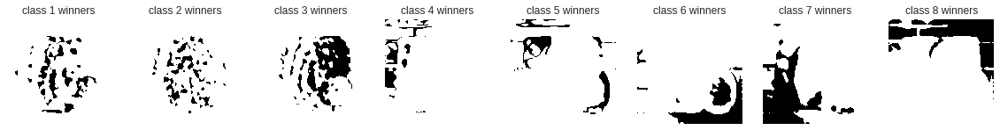

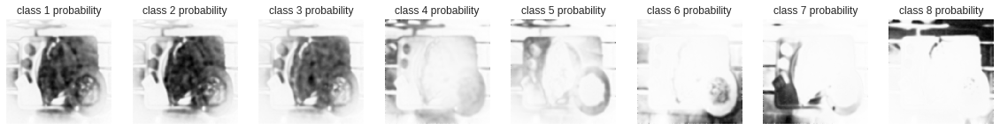

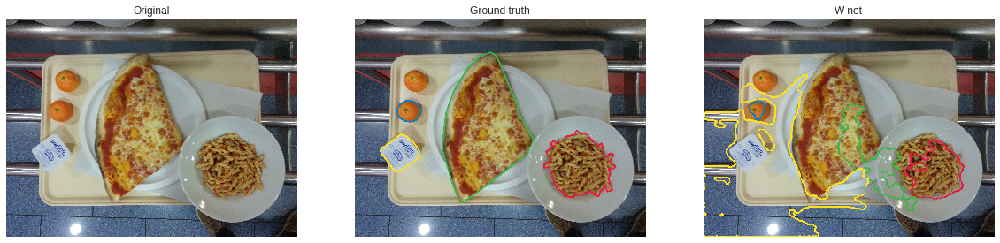

IOU 0.31858279208529816
epoch 2600
1/1 [==============================] - 0s 79ms/step
[5.096951961517334, 0.10089111328125]


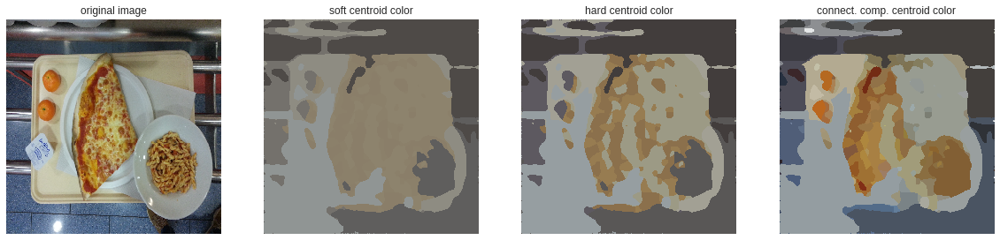

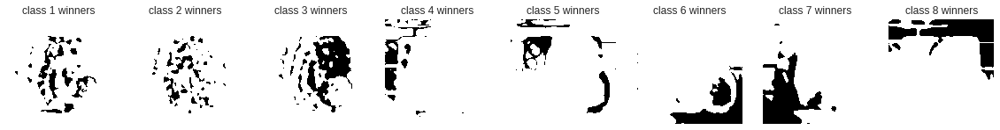

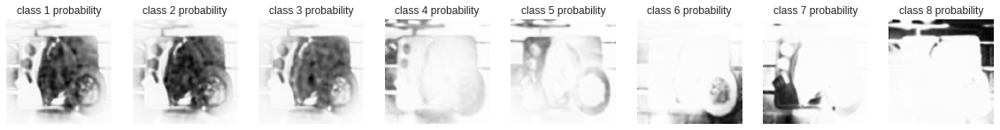

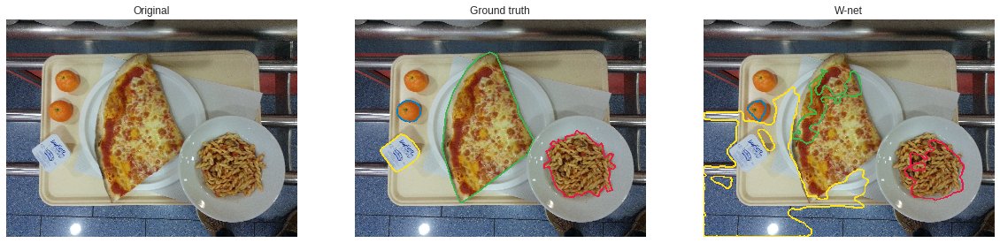

IOU 0.355016738557087
epoch 2800
1/1 [==============================] - 0s 77ms/step
[5.0587944984436035, 0.1025238037109375]


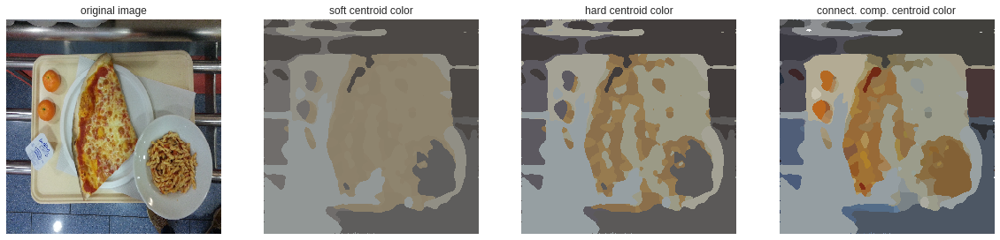

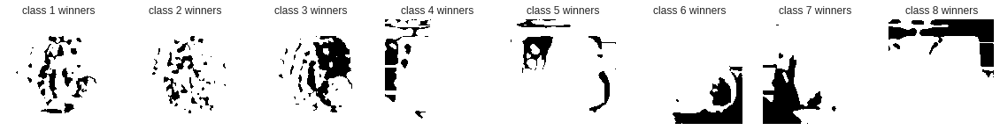

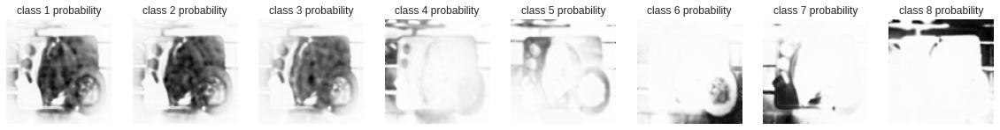

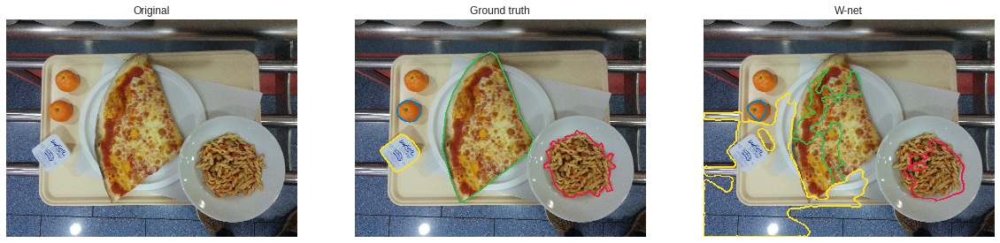

IOU 0.3975512528855442
epoch 3000
1/1 [==============================] - 0s 81ms/step
[5.023120880126953, 0.1059417724609375]


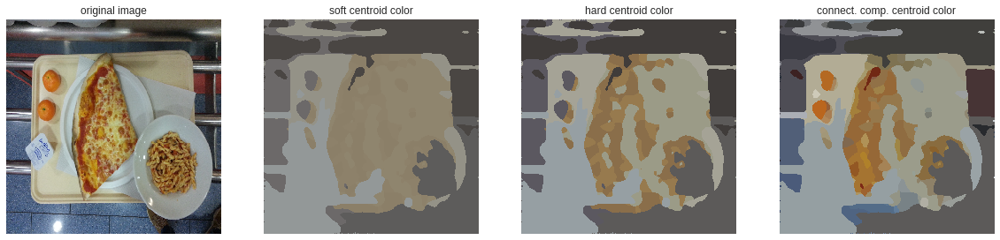

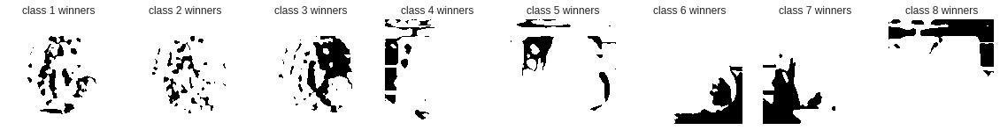

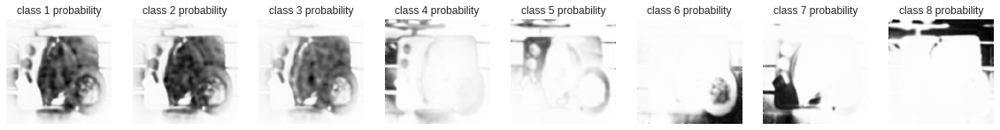

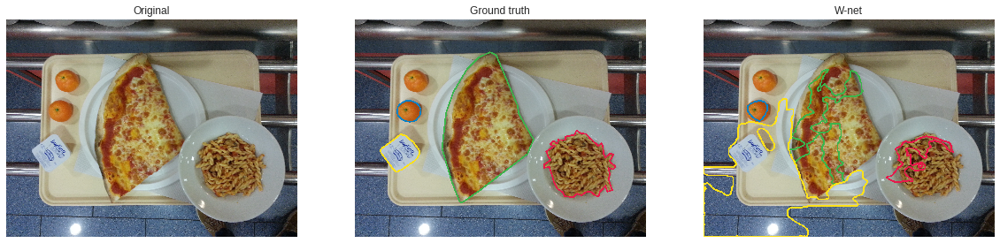

IOU 0.32875968394566024
epoch 3200
1/1 [==============================] - 0s 77ms/step
[4.99057674407959, 0.1079254150390625]


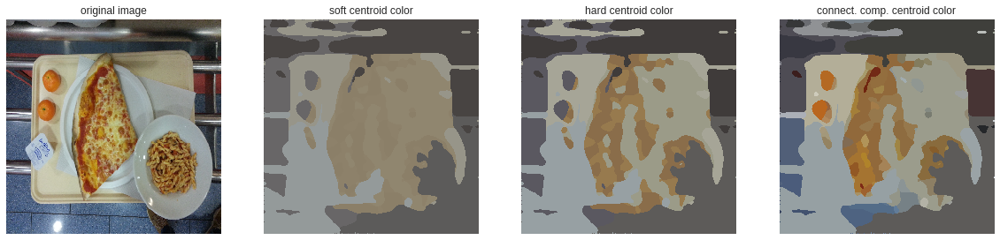

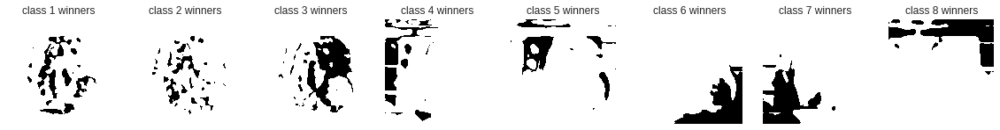

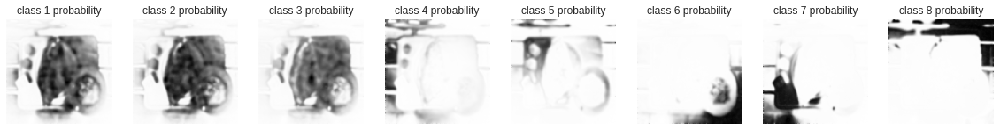

KeyboardInterrupt: ignored

In [28]:
for i in range(50):
  print('epoch',i*200)
  history = e_net.fit(np.array([dummy_input]),np.array([img.reshape((ROWS*COLS,CHANNELS))]),
                      batch_size=1,epochs=200,verbose=0)
  print(e_net.evaluate(np.array([dummy_input]),np.array([img.reshape((ROWS*COLS,CHANNELS))])))
  y_s=e_net.predict(np.array([dummy_input]),batch_size=1)[0]
  P=np.reshape(y_s,(ROWS,COLS,CLASSES))
  paints(img,P)
  plot_winners(img,P)
  plot_probabilities(img,P)
  P_ = get_connectivity_split(img, to_hard_segm_np(P))
  plot_comparison_contours(img_id, P_)
  print('IOU',segmentation_IOU(img,P,idx))